# Insurance charge prediction 2022
---

> Konstantinos Mpouros <br>
> Github: https://github.com/konstantinosmpouros <br>
> Year: 2023 <br>

## 1. About the project
---

* This project is to fearther increase my skills in analysing and presenting data on jupyter notebook. <br>

> This Jupyter Notebook project focuses on leveraging machine learning techniques to predict insurance charges, providing valuable insights into the factors influencing premium costs. The dataset, likely containing information such as age, BMI, smoking status, and region, will be explored and preprocessed to ensure data quality. <br>
>The project begins with Exploratory Data Analysis (EDA) to uncover potential correlations and patterns within the data. Descriptive statistics and visualizations will be employed to understand the distribution of variables and identify any outliers.<br>

>The core of the project involves implementing and evaluating various machine learning models, such as regression models or ensemble methods, to predict insurance charges accurately. <br>
>Hyperparameter tuning, cross-validation, and feature importance analysis will be conducted to optimize model performance and gain insights into the relative significance of different variables. The project aims to develop a reliable model capable of accurately predicting insurance charges while providing a clear understanding of the underlying factors influencing pricing variations.<br>
>The ultimate goal is to create a well-documented Jupyter Notebook that not only produces an accurate predictive model for insurance charges but also provides a comprehensive narrative of the exploratory and analytical processes. This project contributes to the domain of insurance analytics, demonstrating the practical application of machine learning in understanding and predicting insurance costs.

## 2. Data loading and Libraries
---

In [1]:
# Data Manipulation
import pandas as pd
import numpy as np

# Visualization
from matplotlib import pyplot as plt
import seaborn as sns
from sklearn.tree import plot_tree
from optuna.visualization import plot_optimization_history
from optuna.visualization import plot_param_importances
from optuna.visualization import plot_rank
from optuna.visualization import plot_timeline

# Data Spliting  and Normalization
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Cross Validation and Hyperparameter Tuning
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.pipeline import make_pipeline
import optuna

# Model Metrics
from sklearn.metrics import mean_absolute_error as mae
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score as r2
from statsmodels.stats.outliers_influence import variance_inflation_factor as vif

# Model exportation
import pickle

sns.set_style('darkgrid')
pd.set_option('display.max_columns', None)

In [2]:
# Stats Models
import statsmodels.api as sm
import scipy.stats as stats

# Linear Models
from sklearn.linear_model import Ridge
from sklearn.linear_model import RidgeCV
from sklearn.linear_model import BayesianRidge
from sklearn.linear_model import Lasso
from sklearn.linear_model import LassoCV
from sklearn.linear_model import SGDRegressor

# Support Vector Regressor
from sklearn.svm import SVR

# KNN Regressor
from sklearn.neighbors import KNeighborsRegressor

# Decision Trees and Ensemble models
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import AdaBoostRegressor

# Clustering
from sklearn.mixture import BayesianGaussianMixture
from sklearn.mixture import GaussianMixture

In [3]:
import warnings

warnings.filterwarnings("ignore")

In [4]:
insurance_df = pd.read_csv('Datasets/insurance.csv')
insurance_df.head()

,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520


In [5]:
insurance_df.shape

(1338, 7)

## 3. EDA and Data Understanding
---

In [6]:
insurance_df.describe()

,age,bmi,children,charges
count,1338.000000,1338.000000,1338.000000,1338.000000
mean,39.207025,30.663397,1.094918,13270.422265
std,14.049960,6.098187,1.205493,12110.011237
min,18.000000,15.960000,0.000000,1121.873900
25%,27.000000,26.296250,0.000000,4740.287150
50%,39.000000,30.400000,1.000000,9382.033000
75%,51.000000,34.693750,2.000000,16639.912515
max,64.000000,53.130000,5.000000,63770.428010


> As we see there no NaN values so thats good

In [7]:
insurance_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1338 entries, 0 to 1337
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       1338 non-null   int64  
 1   sex       1338 non-null   object 
 2   bmi       1338 non-null   float64
 3   children  1338 non-null   int64  
 4   smoker    1338 non-null   object 
 5   region    1338 non-null   object 
 6   charges   1338 non-null   float64
dtypes: float64(2), int64(2), object(3)
memory usage: 73.3+ KB


In [8]:
insurance_df.isna().sum()

age         0
sex         0
bmi         0
children    0
smoker      0
region      0
charges     0
dtype: int64

> Lets check about the ourliers of the columns

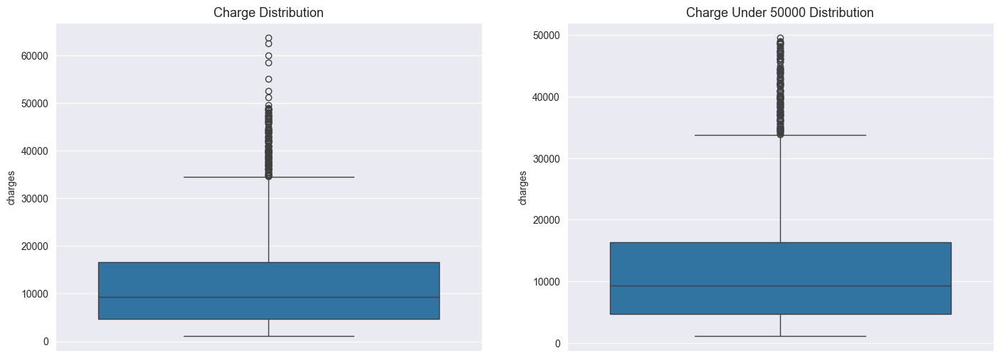

In [9]:
fig, axs = plt.subplots(1, 2, figsize=(17, 6)) 

_= sns.boxplot(y=insurance_df['charges'], ax=axs[0])
axs[0].set_title('Charge Distribution', fontsize=13)

_= sns.boxplot(y=insurance_df.query('charges < 50000')['charges'], ax=axs[1])
axs[1].set_title('Charge Under 50000 Distribution', fontsize=13)

plt.savefig('Graphs/charges_distribution.png')
plt.show()

In [10]:
insurance_df.query('charges >= 50000')

,age,sex,bmi,children,smoker,region,charges
34,28,male,36.400,1,yes,southwest,51194.55914
543,54,female,47.410,0,yes,southeast,63770.42801
577,31,female,38.095,1,yes,northeast,58571.07448
819,33,female,35.530,0,yes,northwest,55135.40209
1146,60,male,32.800,0,yes,southwest,52590.82939
1230,52,male,34.485,3,yes,northwest,60021.39897
1300,45,male,30.360,0,yes,southeast,62592.87309


In [11]:
insurance_df = insurance_df.query('charges < 50000')

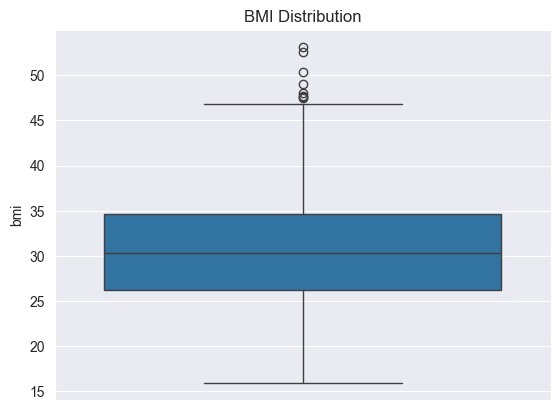

In [12]:
_= sns.boxplot(y=insurance_df['bmi'])
plt.title('BMI Distribution')
plt.savefig('Graphs/bmi_distribution.png')

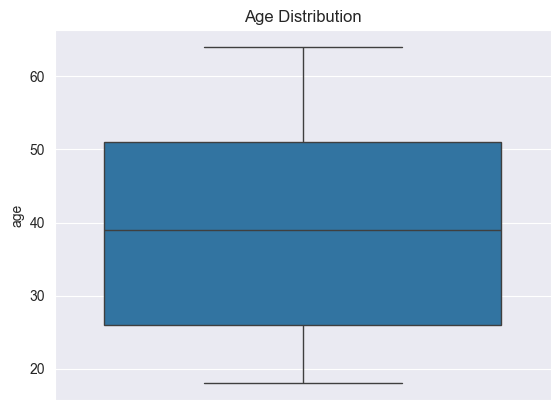

In [13]:
_= sns.boxplot(y=insurance_df['age'])
plt.title('Age Distribution')
plt.savefig('Graphs/age_distribution.png')

In [14]:
print(insurance_df["smoker"].nunique())
print(insurance_df["sex"].nunique())
print(insurance_df["region"].nunique())

2
2
4


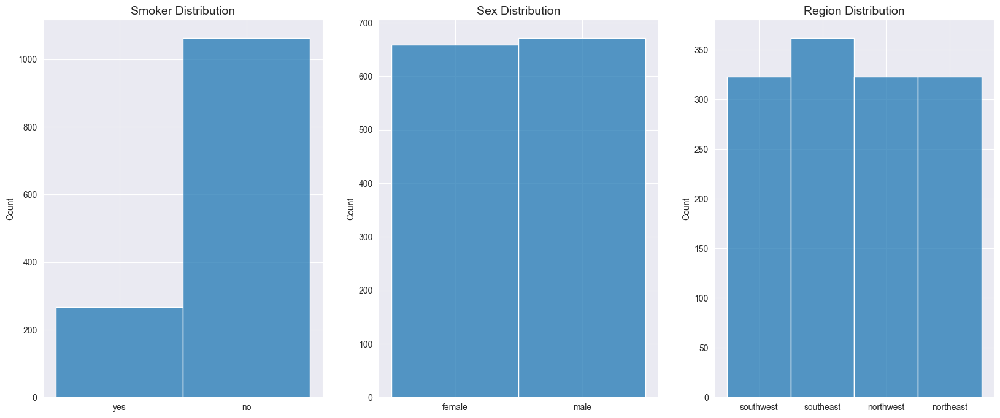

In [15]:
fig, axs = plt.subplots(1, 3, figsize=(20, 8))

_= sns.histplot(insurance_df['smoker'], ax=axs[0])
axs[0].set_title('Smoker Distribution', fontsize=14)
axs[0].set_xlabel(None)

_= sns.histplot(insurance_df['sex'], ax=axs[1])
axs[1].set_title('Sex Distribution', fontsize=14)
axs[1].set_xlabel(None)

_= sns.histplot(insurance_df['region'], ax=axs[2])
axs[2].set_title('Region Distribution', fontsize=14)
axs[2].set_xlabel(None)

plt.savefig('Graphs/categories_distrib.png')
plt.show()

> Lets now check about the correlations between the columns

In [16]:
pd.get_dummies(insurance_df, drop_first=True, dtype=int).corr()

,age,bmi,children,charges,sex_male,smoker_yes,region_northwest,region_southeast,region_southwest
age,1.000000,0.108331,0.043197,0.304561,-0.022425,-0.028377,-0.000367,-0.013238,0.009735
bmi,0.108331,1.000000,0.014860,0.187061,0.048915,-0.006159,-0.136642,0.270376,-0.005691
children,0.043197,0.014860,1.000000,0.076993,0.016042,0.011084,0.022816,-0.021127,0.022816
charges,0.304561,0.187061,0.076993,1.000000,0.057519,0.785617,-0.043506,0.074787,-0.045242
sex_male,-0.022425,0.048915,0.016042,0.057519,1.000000,0.075786,-0.010787,0.017669,-0.007282
smoker_yes,-0.028377,-0.006159,0.011084,0.785617,0.075786,1.000000,-0.038487,0.069074,-0.038487
region_northwest,-0.000367,-0.136642,0.022816,-0.043506,-0.010787,-0.038487,1.000000,-0.345990,-0.320437
region_southeast,-0.013238,0.270376,-0.021127,0.074787,0.017669,0.069074,-0.345990,1.000000,-0.345990
region_southwest,0.009735,-0.005691,0.022816,-0.045242,-0.007282,-0.038487,-0.320437,-0.345990,1.000000


In [17]:
_= sns.pairplot(insurance_df)
plot = plt.gcf()
plt.savefig('Graphs/pairplot.png')
plt.close()

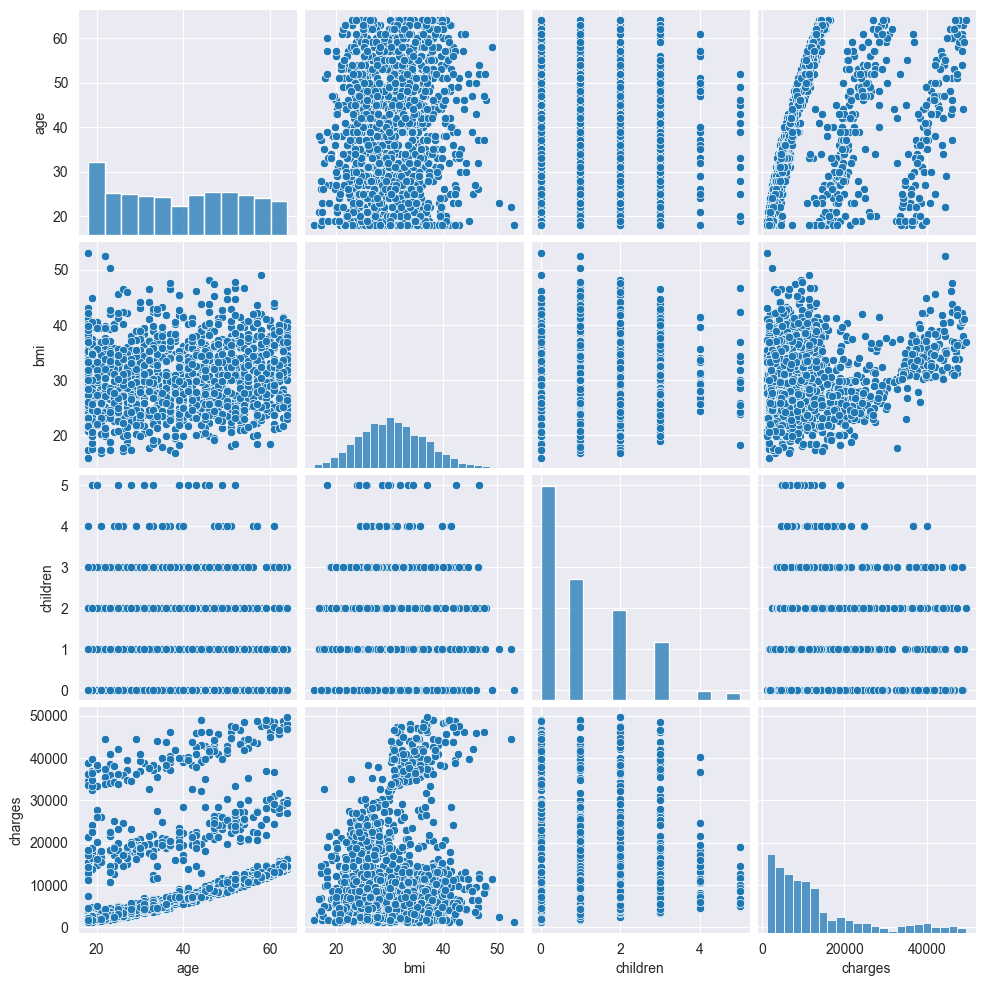

In [18]:
plot

In [19]:
_= sns.pairplot(insurance_df, hue='smoker', hue_order=['no', 'yes'])
plot = plt.gcf()
plt.savefig('Graphs/hued_pairplot.png')
plt.close()

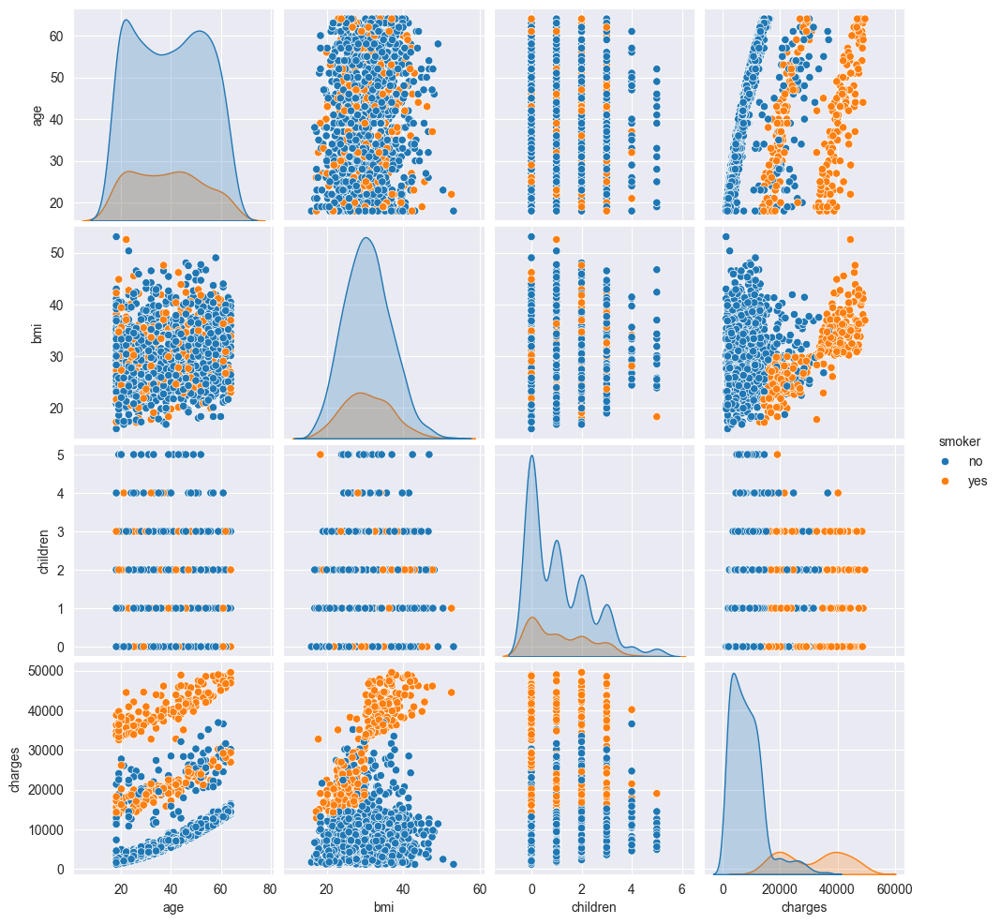

In [20]:
plot

> Lets see this in a heatmap

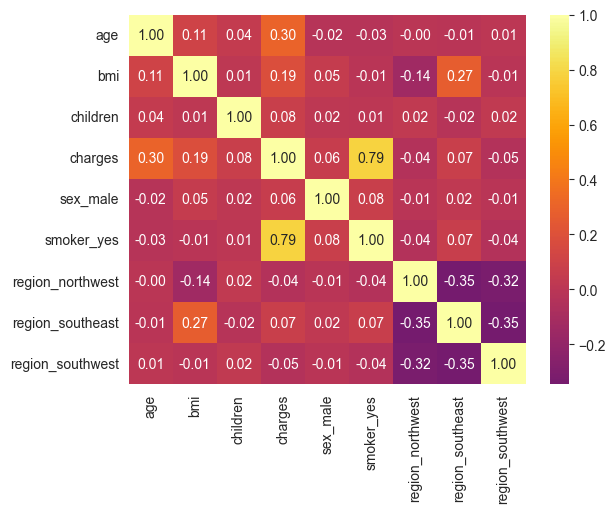

In [21]:
_= sns.heatmap(pd.get_dummies(insurance_df, drop_first=True, dtype=int).corr(), cmap='inferno', annot=True, fmt=".2f", cbar=True, center=0)
plt.savefig('Graphs/heatmap1.png')
plt.show()

> The categorical columns must be casted to dummies in order to use them in the model

In [22]:
dummy = pd.get_dummies(insurance_df.iloc[:, [1, 4, 5]], drop_first=True, dtype=int)
dummy.head()

,sex_male,smoker_yes,region_northwest,region_southeast,region_southwest
0,0,1,0,0,1
1,1,0,0,1,0
2,1,0,0,1,0
3,1,0,1,0,0
4,1,0,1,0,0


In [23]:
insurance_df = insurance_df.join(dummy)
insurance_df.head()

,age,sex,bmi,children,smoker,region,charges,sex_male,smoker_yes,region_northwest,region_southeast,region_southwest
0,19,female,27.900,0,yes,southwest,16884.92400,0,1,0,0,1
1,18,male,33.770,1,no,southeast,1725.55230,1,0,0,1,0
2,28,male,33.000,3,no,southeast,4449.46200,1,0,0,1,0
3,33,male,22.705,0,no,northwest,21984.47061,1,0,1,0,0
4,32,male,28.880,0,no,northwest,3866.85520,1,0,1,0,0


> In the pairplot age-charges we can see that the scatterplot is like 3 independent line, like 3 groups of different costumers and also 3 different level of charges. Lets try to find this clusters

In [24]:
variables = [
    'age',
#     'sex_male',
#     'smoker_yes',
#     'region_northwest',
#     'region_southeast',
#     'region_southwest',
#     'children',
#     'bmi',
    'charges'
]

clustering_variables = insurance_df[variables]

# Clustering Bayesian Gaussian Mixture
bgm = BayesianGaussianMixture(n_components=3,
                              covariance_type='full',
                              tol=.001,
                              random_state=33).fit(clustering_variables)

# Clustering Gaussian Mixture
gm = GaussianMixture(n_components=3,
                     covariance_type='full',
                     tol=2,
                     random_state=33).fit(clustering_variables)

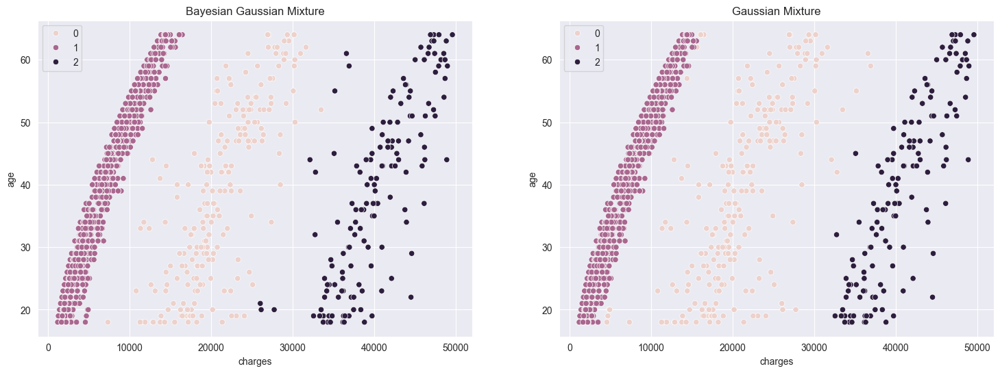

In [25]:
fig, axs = plt.subplots(1, 2, figsize=(18, 6))

_= sns.scatterplot(x=insurance_df['charges'],
                   y=insurance_df['age'],
                   hue=bgm.predict(clustering_variables),
                   ax=axs[0])
axs[0].set_title('Bayesian Gaussian Mixture')

_= sns.scatterplot(x=insurance_df['charges'],
                   y=insurance_df['age'],
                   hue=gm.predict(clustering_variables),
                   ax=axs[1])
axs[1].set_title('Gaussian Mixture')
plt.savefig('Graphs/gaussian_clustering.png')
plt.show()

In [26]:
insurance_df['BGM_cluster'] = bgm.predict(clustering_variables)

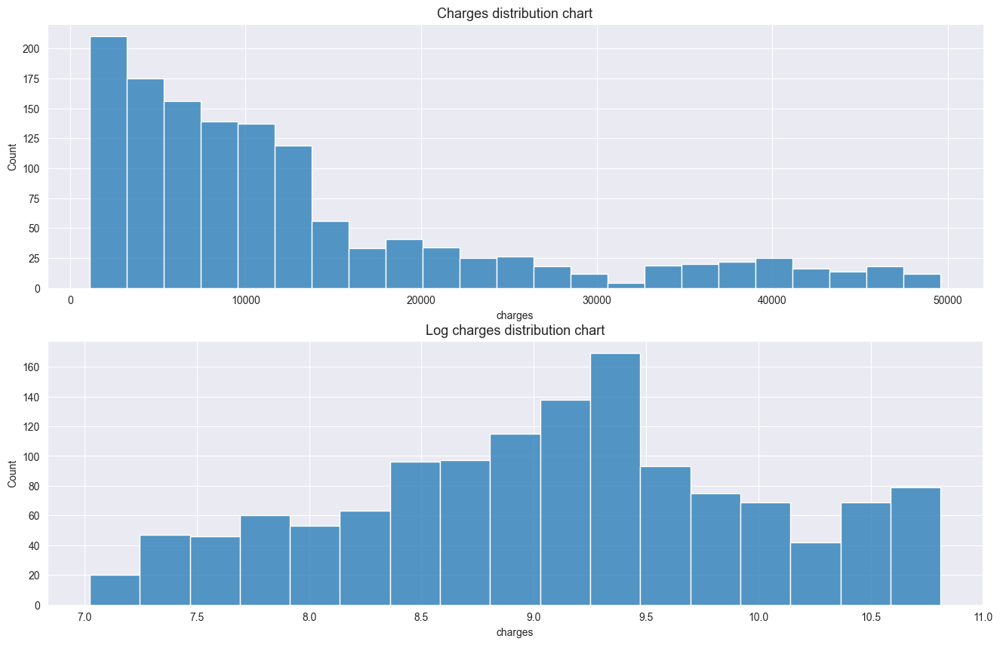

In [27]:
fig, axs = plt.subplots(2, 1, figsize=(16,10))

_= sns.histplot(data=insurance_df['charges'], ax=axs[0])
axs[0].set_title('Charges distribution chart', fontsize=13)
_= sns.histplot(data=np.log(insurance_df['charges']), ax=axs[1])
axs[1].set_title('Log charges distribution chart', fontsize=13)

plt.savefig('Graphs/log_charges_distrib.png')
plt.show()

> Some feature engineering that has been done in order to find combinations of columns that the model could gain knowledge. The commented line are features that didnt helped the model learn

In [28]:
insurance_df.columns

Index(['age', 'sex', 'bmi', 'children', 'smoker', 'region', 'charges',
       'sex_male', 'smoker_yes', 'region_northwest', 'region_southeast',
       'region_southwest', 'BGM_cluster'],
      dtype='object')

In [29]:
insurance_df['bmi_age'] = insurance_df['bmi'] * insurance_df['age']
insurance_df['sqr_bmi'] = insurance_df['bmi']**2
insurance_df['bmi_smoker'] = insurance_df['bmi'] * insurance_df['smoker_yes']
insurance_df['age_smoker'] = insurance_df['age'] * insurance_df['smoker_yes']
insurance_df['sqr_age'] = insurance_df['age'] **2

> Lets check again the correlations and the heatmap

In [30]:
insurance_df

,age,sex,bmi,children,smoker,region,charges,sex_male,smoker_yes,region_northwest,region_southeast,region_southwest,BGM_cluster,bmi_age,sqr_bmi,bmi_smoker,age_smoker,sqr_age
0,19,female,27.900,0,yes,southwest,16884.92400,0,1,0,0,1,0,530.100,778.410000,27.90,19,361
1,18,male,33.770,1,no,southeast,1725.55230,1,0,0,1,0,1,607.860,1140.412900,0.00,0,324
2,28,male,33.000,3,no,southeast,4449.46200,1,0,0,1,0,1,924.000,1089.000000,0.00,0,784
3,33,male,22.705,0,no,northwest,21984.47061,1,0,1,0,0,0,749.265,515.517025,0.00,0,1089
4,32,male,28.880,0,no,northwest,3866.85520,1,0,1,0,0,1,924.160,834.054400,0.00,0,1024
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1333,50,male,30.970,3,no,northwest,10600.54830,1,0,1,0,0,1,1548.500,959.140900,0.00,0,2500
1334,18,female,31.920,0,no,northeast,2205.98080,0,0,0,0,0,1,574.560,1018.886400,0.00,0,324
1335,18,female,36.850,0,no,southeast,1629.83350,0,0,0,1,0,1,663.300,1357.922500,0.00,0,324
1336,21,female,25.800,0,no,southwest,2007.94500,0,0,0,0,1,1,541.800,665.640000,0.00,0,441


In [31]:
insurance_df.drop(columns=['region', 'smoker', 'sex'], inplace=True)

In [32]:
insurance_df.corr()

,age,bmi,children,charges,sex_male,smoker_yes,region_northwest,region_southeast,region_southwest,BGM_cluster,bmi_age,sqr_bmi,bmi_smoker,age_smoker,sqr_age
age,1.000000,0.108331,0.043197,0.304561,-0.022425,-0.028377,-0.000367,-0.013238,0.009735,0.013544,0.880256,0.099558,-0.022473,0.140619,0.988363
bmi,0.108331,1.000000,0.014860,0.187061,0.048915,-0.006159,-0.136642,0.270376,-0.005691,0.294912,0.538080,0.991436,0.097093,0.003355,0.112100
children,0.043197,0.014860,1.000000,0.076993,0.016042,0.011084,0.022816,-0.021127,0.022816,-0.005495,0.045003,0.014867,0.010580,0.024250,-0.002753
charges,0.304561,0.187061,0.076993,1.000000,0.057519,0.785617,-0.043506,0.074787,-0.045242,0.292178,0.333615,0.181006,0.842208,0.786636,0.307447
sex_male,-0.022425,0.048915,0.016042,0.057519,1.000000,0.075786,-0.010787,0.017669,-0.007282,0.058499,0.006326,0.049377,0.090458,0.068198,-0.022159
smoker_yes,-0.028377,-0.006159,0.011084,0.785617,0.075786,1.000000,-0.038487,0.069074,-0.038487,0.123056,-0.030687,-0.003047,0.974690,0.926617,-0.029034
region_northwest,-0.000367,-0.136642,0.022816,-0.043506,-0.010787,-0.038487,1.000000,-0.345990,-0.320437,-0.046944,-0.064820,-0.144397,-0.050234,-0.030784,-0.000382
region_southeast,-0.013238,0.270376,-0.021127,0.074787,0.017669,0.069074,-0.345990,1.000000,-0.345990,0.067760,0.102351,0.279230,0.096153,0.074216,-0.011284
region_southwest,0.009735,-0.005691,0.022816,-0.045242,-0.007282,-0.038487,-0.320437,-0.345990,1.000000,0.040341,0.013795,-0.012316,-0.035022,-0.050854,0.007687
BGM_cluster,0.013544,0.294912,-0.005495,0.292178,0.058499,0.123056,-0.046944,0.067760,0.040341,1.000000,0.141676,0.288117,0.266385,0.122338,0.016305


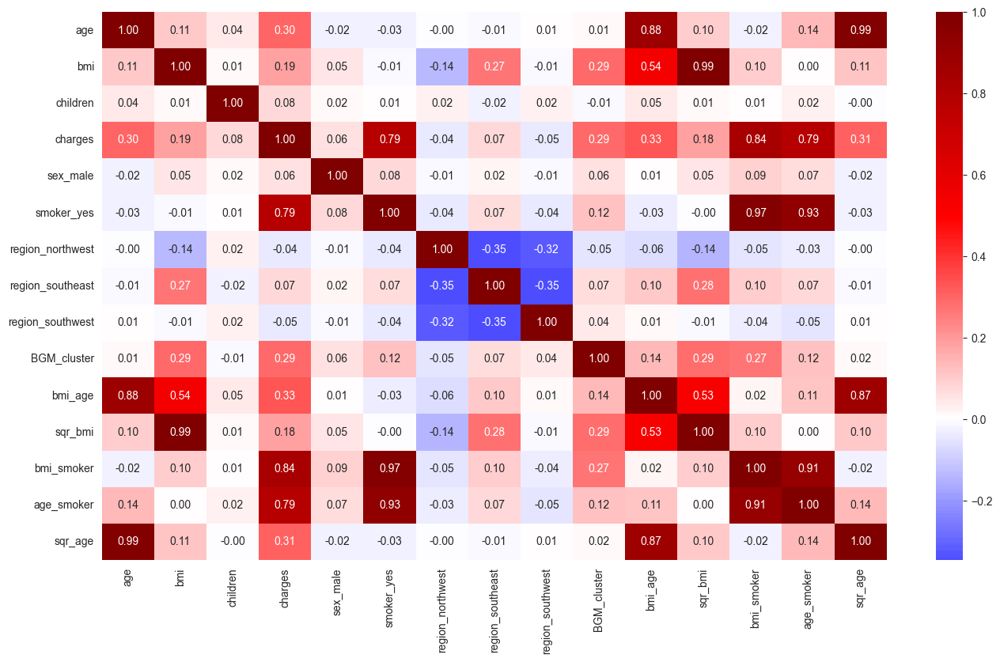

In [33]:
plt.figure(figsize=(16,9))
_= sns.heatmap(insurance_df.corr(), cmap='seismic', annot=True, fmt=".2f", cbar=True, center=0)
plt.savefig('Graphs/heatmap2.png')
plt.show()

## 4. Modeling
---

### Linear Regression

> First l initialize some methods that we will use in order to faster print metrics about the models

In [34]:
def resid_predict_plots(model, y, X, string):
    fig, axs = plt.subplots(1, 2, sharey=True, figsize=(18, 6))

    sns.scatterplot(y=y - model.predict(X),
                    x=model.predict(X),
                    alpha=.45,
                    ax=axs[0]
    )
    axs[0].set_title('Residuals plot')
    axs[0].set_xlabel('Predictions')
    axs[0].set_ylabel('Residuals')

    _= stats.probplot(y - model.predict(X), dist='norm', plot=axs[1])
    _= axs[1].set_title('Q-Q normality plot')
    
    plt.savefig(f'Graphs/{string}.png')

def model_metrics(model, x, y):
    print(f"MAE: {round(mae(y, model.predict(x)), 2)}")
    print(f"MSE: {round(mse(y, model.predict(x), squared=True), 2)}")
    print(f"RMSE: {round(mse(y, model.predict(x), squared=False), 2)}")
    print(f"R2: {round(r2(y, model.predict(x)), 4)}")
    
def multicollinearity_metric(model, x, y):
    varibles = sm.OLS(y, x).exog
    vif_metrics = pd.DataFrame([vif(varibles, i) for i in range(varibles.shape[1])], columns=['VIF'])
    vif_metrics = vif_metrics.set_index(x.columns)
    print(vif_metrics)

> Lets now create the feature and target variables

In [35]:
insurance_df.columns

Index(['age', 'bmi', 'children', 'charges', 'sex_male', 'smoker_yes',
       'region_northwest', 'region_southeast', 'region_southwest',
       'BGM_cluster', 'bmi_age', 'sqr_bmi', 'bmi_smoker', 'age_smoker',
       'sqr_age'],
      dtype='object')

In [36]:
features = [
    # 'age',
    # 'bmi',
    'sex_male',
    'children',
    # 'region_northwest',
    'region_southeast',
    'region_southwest',
    'BGM_cluster',
    'smoker_yes',
    # 'bmi_age',
    # 'sqr_bmi',
    'sqr_age',
    'bmi_smoker',
    # 'age_smoker'
]

X = sm.add_constant(insurance_df[features])
y = insurance_df['charges']

>  Split them into train and test data and then train the model

In [37]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=33)
ols = sm.OLS(y_train, X_train).fit()

In [38]:
ols.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                charges   R-squared:                       0.859
Model:                            OLS   Adj. R-squared:                  0.858
Method:                 Least Squares   F-statistic:                     804.9
Date:                Mon, 29 Jan 2024   Prob (F-statistic):               0.00
Time:                        21:37:47   Log-Likelihood:                -10434.
No. Observations:                1064   AIC:                         2.089e+04
Df Residuals:                    1055   BIC:                         2.093e+04
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
====================================================================================
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const             3857.8130    476.285      8.100      0.000    2923.239    4792.387
sex_male          -570.7589    272.674     -2.093      0.037   -1105.804     -35.714
children           625.8899    112.538      5.562      0.000     405.067     846.713
region_southeast  -754.3554    329.314     -2.291      0.022   -1400.540    -108.171
region_southwest  -801.9233    337.239     -2.378      0.018   -1463.659    -140.187
BGM_cluster      -1456.5943    350.555     -4.155      0.000   -2144.459    -768.730
smoker_yes       -2.463e+04   2001.533    -12.304      0.000   -2.86e+04   -2.07e+04
sqr_age              3.3137      0.120     27.611      0.000       3.078       3.549
bmi_smoker        1584.0327     65.708     24.107      0.000    1455.099    1712.966
==============================================================================
Omnibus:                      495.047   Durbin-Watson:                   1.851
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             2606.167
Skew:                           2.143   Prob(JB):                         0.00
Kurtosis:                       9.357   Cond. No.                     3.11e+04
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 3.11e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

> The model score accually is good. Lets see some metrics about the errors and then check others methods that could improve the performance.

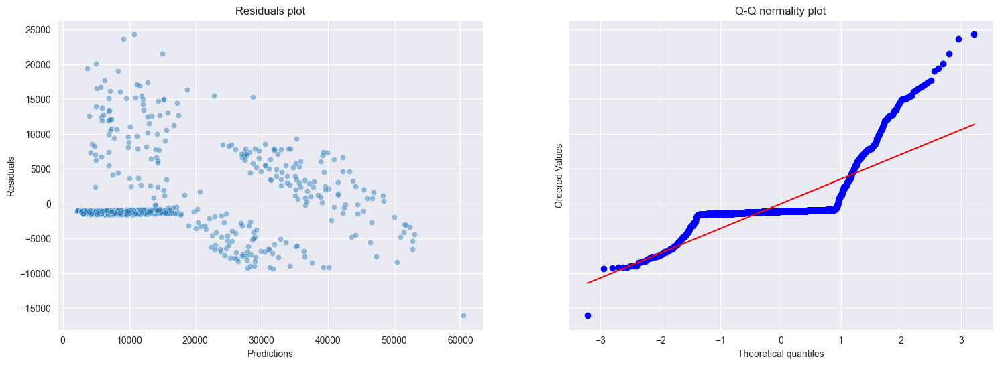

In [39]:
resid_predict_plots(ols, y_train, X_train, 'resid_prediction_plots')

In [40]:
print('*** Training data scores and metrics ***')
model_metrics(ols, X_train, y_train)

*** Training data scores and metrics ***
MAE: 2661.93
MSE: 19288815.88
RMSE: 4391.9
R2: 0.8592


> Columns that has created from other columns is obvious that might have a higher than normal VIF but this doesnt affect cause it gained knowledge from that

In [41]:
multicollinearity_metric(ols, X_train, y_train)

                        VIF
const             12.407395
sex_male           1.016568
children           1.001626
region_southeast   1.188589
region_southwest   1.145607
BGM_cluster        1.800986
smoker_yes        34.835375
sqr_age            1.006792
bmi_smoker        37.476922


> The score on the test data seems to be lower than the trained score. Lets check this in a cross validation to see some more info.

In [42]:
print('*** Test data scores and metrics ***')
model_metrics(ols, X_test, y_test)

*** Test data scores and metrics ***
MAE: 3081.51
MSE: 28726622.63
RMSE: 5359.72
R2: 0.7884


### Linear Regression Cross Validation

> We actually see that the true score the linear regression have is quit bigger. But the range or the scores in cross validation makes us think that linear regression might not learned the patterns of our data.

In [43]:
kf = KFold(n_splits=10, shuffle=True, random_state=33)

cross_valid = []

for train_id, test_id in kf.split(X, y):
    X_train, y_train = X.iloc[train_id], y.iloc[train_id]
    X_test, y_test = X.iloc[test_id], y.iloc[test_id]
    
    ols = sm.OLS(y_train, X_train).fit()
    cross_valid.append(r2(y_test, ols.predict(X_test)))

print("Cross Validation Scores: ", [round(x, 4) for x in cross_valid])
print(f"Cross Validation Average Score: {round(np.mean(cross_valid), 4)} +- {round(np.std(cross_valid), 4)}" )

Cross Validation Scores:  [0.7713, 0.8056, 0.8183, 0.8099, 0.8763, 0.7301, 0.9152, 0.8721, 0.8988, 0.85]
Cross Validation Average Score: 0.8348 +- 0.0553


### Ridge Regression

> Lets now see if we add a penalty will improve the performance of the model, by starting with l1 penalty which is Ridge Regression

> We will use a random Hyperparam at the beggining and then try to optimize it

In [44]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=33)

ridge = Ridge(alpha=1)
ridge.fit(X_train, y_train)

Ridge(alpha=1)

In [45]:
ridge.score(X_test, y_test)

0.7885254121714089

In [46]:
model_metrics(ridge, X_test, y_test)

MAE: 3090.57
MSE: 28708070.91
RMSE: 5357.99
R2: 0.7885


In [47]:
print('*** Ridge Coefficients ***')
list(zip(X_train.columns, ridge.coef_))

*** Ridge Coefficients ***


[('const', 0.0),
 ('sex_male', -522.81788393846),
 ('children', 623.5311206092836),
 ('region_southeast', -654.6353366624277),
 ('region_southwest', -789.0877179795052),
 ('BGM_cluster', -994.4372467530409),
 ('smoker_yes', -20391.4514141062),
 ('sqr_age', 3.325026703966588),
 ('bmi_smoker', 1446.9954689825518)]

### RidgeCV Regression

> Lets now try optimize the alpha hyperparam in order to find the highest performance ridge regression can give us. <br>
> But as we can see the best alpha is 0.05 without any significant increase in the score so the l1 penalty actually failed to improve the model.

In [48]:
alphas = np.concatenate([np.linspace(0.00001, 1, 50), np.linspace(1, 100, 25), np.linspace(100, 1000, 25)])

ridgecv = RidgeCV(alphas=alphas, cv=10)
ridgecv.fit(X_train, y_train)

RidgeCV(alphas=array([1.00000000e-05, 2.04179592e-02, 4.08259184e-02, 6.12338776e-02,
       8.16418367e-02, 1.02049796e-01, 1.22457755e-01, 1.42865714e-01,
       1.63273673e-01, 1.83681633e-01, 2.04089592e-01, 2.24497551e-01,
       2.44905510e-01, 2.65313469e-01, 2.85721429e-01, 3.06129388e-01,
       3.26537347e-01, 3.46945306e-01, 3.67353265e-01, 3.87761224e-01,
       4.08169184e-01, 4.28577143e-0...
       1.37500000e+02, 1.75000000e+02, 2.12500000e+02, 2.50000000e+02,
       2.87500000e+02, 3.25000000e+02, 3.62500000e+02, 4.00000000e+02,
       4.37500000e+02, 4.75000000e+02, 5.12500000e+02, 5.50000000e+02,
       5.87500000e+02, 6.25000000e+02, 6.62500000e+02, 7.00000000e+02,
       7.37500000e+02, 7.75000000e+02, 8.12500000e+02, 8.50000000e+02,
       8.87500000e+02, 9.25000000e+02, 9.62500000e+02, 1.00000000e+03]),
        cv=10)

In [49]:
ridgecv.score(X_test, y_test)

0.7884292236854538

In [50]:
model_metrics(ridgecv, X_test, y_test)

MAE: 3081.9
MSE: 28721128.68
RMSE: 5359.21
R2: 0.7884


In [51]:
ridgecv.alpha_

0.04082591836734694

In [52]:
model_metrics(ridgecv, X_test, y_test)

MAE: 3081.9
MSE: 28721128.68
RMSE: 5359.21
R2: 0.7884


In [53]:
print('*** RidgeCV Coefficients ***')
list(zip(X_train.columns, ridgecv.coef_))

*** RidgeCV Coefficients ***


[('const', 0.0),
 ('sex_male', -568.4238713527177),
 ('children', 625.7782497264952),
 ('region_southeast', -749.5001189339697),
 ('region_southwest', -801.3356531881427),
 ('BGM_cluster', -1433.9398497824202),
 ('smoker_yes', -24419.86124857321),
 ('sqr_age', 3.3142127676225006),
 ('bmi_smoker', 1577.3270751551584)]

### Bayesian Ridge Regression

> Actually Ridge Regression didnt worked so lets try a similar method that is Bayesian Ridge Regression. Again and from now and on the concept is the same, try to optimize the models to find the best performance of each one.

In [54]:
bayesian_ridge = BayesianRidge(alpha_1=1,
                               alpha_2=1,
                               lambda_1=3,
                               lambda_2=1,
                               n_iter=100)
bayesian_ridge.fit(X_train, y_train)

BayesianRidge(alpha_1=1, alpha_2=1, lambda_1=3, lambda_2=1, n_iter=100)

In [55]:
bayesian_ridge.score(X_test, y_test)

0.7886451538637358

In [56]:
model_metrics(bayesian_ridge, X_test, y_test)

MAE: 3086.17
MSE: 28691815.75
RMSE: 5356.47
R2: 0.7886


In [57]:
bayesian_ridge.n_iter_

51

In [58]:
print('*** Bayesian Ridge Coefficients ***')
list(zip(X_train.columns, bayesian_ridge.coef_))

*** Bayesian Ridge Coefficients ***


[('const', 0.0),
 ('sex_male', -542.4561134801047),
 ('children', 624.5158757717663),
 ('region_southeast', -695.4930556328516),
 ('region_southwest', -794.5597281630237),
 ('BGM_cluster', -1182.9237919443049),
 ('smoker_yes', -22121.079456904394),
 ('sqr_age', 3.320379270867137),
 ('bmi_smoker', 1502.9523232721901)]

### Bayesian Ridge Regression Optuna

> In order to optimize the Bayesian Ridge Regression we will use a very powerfull library called optuna. Optuna need to initialize a method that will determine the hyperparameter suggestions it will conduct and then run it in order to find the optimal hyperparams.

In [59]:
def objective_bridge(trial):

    alpha_1 = trial.suggest_float('alpha_1', 0, 10)
    alpha_2 = trial.suggest_float('alpha_2', 0, 10)
    lambda_1 = trial.suggest_float('lambda_1', 0, 10)
    lambda_2 = trial.suggest_float('lambda_2', 0, 10)
    
    bayesian_ridge = BayesianRidge(alpha_1=alpha_1,
                                   alpha_2=alpha_2,
                                   lambda_1=lambda_1,
                                   lambda_2=lambda_2,
                                   n_iter=100
                                  )

    score = cross_val_score(bayesian_ridge, X_train, y_train, scoring='r2', n_jobs=-1)
    return score.mean()

In [60]:
study_bridge = optuna.create_study(direction="maximize")
study_bridge.optimize(objective_bridge, n_trials=150, n_jobs=-1)

[I 2024-01-29 21:37:49,872] A new study created in memory with name: no-name-f5b42818-1874-4c5d-a899-ee522b046589
[I 2024-01-29 21:37:51,231] Trial 12 finished with value: 0.2471888401637928 and parameters: {'alpha_1': 3.70137242071387, 'alpha_2': 7.2957256042823335, 'lambda_1': 3.376777083006921, 'lambda_2': 4.357787960400927}. Best is trial 12 with value: 0.2471888401637928.
[I 2024-01-29 21:37:51,232] Trial 4 finished with value: 0.0811346801410294 and parameters: {'alpha_1': 7.33908990972048, 'alpha_2': 9.561330722733713, 'lambda_1': 6.957218559126417, 'lambda_2': 0.6672261489123332}. Best is trial 12 with value: 0.2471888401637928.
[I 2024-01-29 21:37:51,233] Trial 13 finished with value: 0.0845152971367118 and parameters: {'alpha_1': 9.401635279135922, 'alpha_2': 1.9061159544555417, 'lambda_1': 5.633061972364257, 'lambda_2': 3.969607937668551}. Best is trial 12 with value: 0.2471888401637928.
[I 2024-01-29 21:37:51,345] Trial 6 finished with value: 0.08409075919481028 and paramet

In [61]:
print('Number of finished trials: ', len(study_bridge.trials))
print('Best trial:')
trial = study_bridge.best_trial

print('Value: ', trial.value)
print('Params: ')
for key, value in trial.params.items():
    print(f'    {key}: {value}')

Number of finished trials:  150
Best trial:
Value:  0.8512750043686076
Params: 
    alpha_1: 4.587774776815585
    alpha_2: 4.499493735841989
    lambda_1: 2.576996369322698
    lambda_2: 8.520381560892536


In [62]:
trials_df = study_bridge.trials_dataframe()
trials_df.sort_values(by='value', ascending=False).head()

,number,value,datetime_start,datetime_complete,duration,params_alpha_1,params_alpha_2,params_lambda_1,params_lambda_2,state
106,106,0.851275,2024-01-29 21:37:52.927062,2024-01-29 21:37:53.196813,0 days 00:00:00.269751,4.587775,4.499494,2.576996,8.520382,COMPLETE
110,110,0.850873,2024-01-29 21:37:52.990813,2024-01-29 21:37:53.290811,0 days 00:00:00.299998,4.584950,4.610319,2.600432,8.593279,COMPLETE
119,119,0.850831,2024-01-29 21:37:53.181814,2024-01-29 21:37:53.494810,0 days 00:00:00.312996,3.872108,4.774912,2.619457,7.921957,COMPLETE
121,121,0.850824,2024-01-29 21:37:53.192811,2024-01-29 21:37:53.527811,0 days 00:00:00.335000,4.726890,4.770779,2.637224,7.737388,COMPLETE
91,91,0.850803,2024-01-29 21:37:52.616061,2024-01-29 21:37:52.925063,0 days 00:00:00.309002,4.456584,3.309514,2.654896,9.456945,COMPLETE


> lets see some visualization that optuna can give us

In [63]:
fig = plot_optimization_history(study_bridge)
fig.update_layout(yaxis_range=[0, 1])

fig.write_html('Graphs/bayesian_ridge_optuna_performance1.html')
fig.show()

In [64]:
fig = plot_param_importances(study_bridge)

fig.write_html('Graphs/bayesian_ridge_optuna_performance2.html')
fig.show()

In [65]:
fig = plot_rank(study_bridge)
fig.update_layout(width=800, height=550)
fig.write_html('Graphs/bayesian_ridge_optuna_performance3.html')
fig.show()

In [66]:
fig = plot_timeline(study_bridge)

fig.write_html('Graphs/bayesian_ridge_optuna_timeline.html')
fig.show()

> The Bayesian Ridge did better with an overall score in the cross validation of 85.09% but lets see one more penalized regression model if can perform better and then move on to even more complex methods.

### Lasso Regression

> Lasso Regression is a penalized regression model that adds a l2 penalty in the loss function of linear regression in order to optimize it more and find also the best coef for the feature variables. With a random alpha value we can see that it did worst than the linear model and the bayesian ridge.

In [67]:
lasso = Lasso(alpha=10)
lasso.fit(X_train, y_train)

Lasso(alpha=10)

In [68]:
lasso.score(X_test, y_test)

0.7887331672322316

In [69]:
model_metrics(lasso, X_test, y_test)

MAE: 3085.66
MSE: 28679867.77
RMSE: 5355.36
R2: 0.7887


In [70]:
print('*** Lasso Coefficients ***')

list(zip(X_train.columns, lasso.coef_))

*** Lasso Coefficients ***


[('const', 0.0),
 ('sex_male', -502.3223350406587),
 ('children', 617.6208064342171),
 ('region_southeast', -620.6546393319242),
 ('region_southwest', -716.6885456174049),
 ('BGM_cluster', -1144.7182012796752),
 ('smoker_yes', -22049.601078640328),
 ('sqr_age', 3.321797229268889),
 ('bmi_smoker', 1499.8542955092419)]

### LassoCV Regression

> If we use a cross validation model to find the best alpha to optimize the Lasso Regression we end but with almost the same score as with the random alpha we gave.

In [71]:
lassocv = LassoCV(alphas=alphas, cv=10)
lassocv.fit(X_train, y_train)

LassoCV(alphas=array([1.00000000e-05, 2.04179592e-02, 4.08259184e-02, 6.12338776e-02,
       8.16418367e-02, 1.02049796e-01, 1.22457755e-01, 1.42865714e-01,
       1.63273673e-01, 1.83681633e-01, 2.04089592e-01, 2.24497551e-01,
       2.44905510e-01, 2.65313469e-01, 2.85721429e-01, 3.06129388e-01,
       3.26537347e-01, 3.46945306e-01, 3.67353265e-01, 3.87761224e-01,
       4.08169184e-01, 4.28577143e-0...
       1.37500000e+02, 1.75000000e+02, 2.12500000e+02, 2.50000000e+02,
       2.87500000e+02, 3.25000000e+02, 3.62500000e+02, 4.00000000e+02,
       4.37500000e+02, 4.75000000e+02, 5.12500000e+02, 5.50000000e+02,
       5.87500000e+02, 6.25000000e+02, 6.62500000e+02, 7.00000000e+02,
       7.37500000e+02, 7.75000000e+02, 8.12500000e+02, 8.50000000e+02,
       8.87500000e+02, 9.25000000e+02, 9.62500000e+02, 1.00000000e+03]),
        cv=10)

In [72]:
lassocv.alpha_

5.125

In [73]:
lassocv.score(X_test, y_test)

0.7886389620214265

In [74]:
model_metrics(lassocv, X_test, y_test)

MAE: 3083.64
MSE: 28692656.31
RMSE: 5356.55
R2: 0.7886


In [75]:
print('*** LassoCV Coefficients ***')

list(zip(X_train.columns, lassocv.coef_))

*** LassoCV Coefficients ***


[('const', 0.0),
 ('sex_male', -535.6845534916148),
 ('children', 621.6519685570842),
 ('region_southeast', -685.8325498153077),
 ('region_southwest', -758.2404256054793),
 ('BGM_cluster', -1296.751822998793),
 ('smoker_yes', -23306.08451640938),
 ('sqr_age', 3.3178291305558725),
 ('bmi_smoker', 1540.889537212125)]

> Even thought the alpha is not 0 and its 1 the performance of the model is lower that the linear one and the bayesian ridge so Lasso actually failed to improve the performance. We keep till us best the Bayesian Ridge and move on to more powerfull and complex models.

### Support Vector Regressor

> SVR aims to find a hyperplane that best fits the data while minimizing errors.<br>
>In order to use Support Vector Regressor we need to scale the values range of our data and then use the model.

In [76]:
scaler_x = StandardScaler()
X_train_scaled = scaler_x.fit_transform(X_train)
X_test_scaled = scaler_x.transform(X_test)

scaler_y = StandardScaler()
y_train_scaled = scaler_y.fit_transform(y_train.values.reshape(-1, 1))
y_test_scaled = scaler_y.transform(y_test.values.reshape(-1, 1))

In [77]:
svr = SVR()
svr.fit(X_train_scaled, y_train_scaled.ravel())

SVR()

> SVR did very good! Without even hyperparameters optimized is surpassed every model so far. 

In [78]:
svr.score(X_test_scaled, y_test_scaled)

0.9584703442732599

In [79]:
model_metrics(svr, X_test_scaled, y_test_scaled)

MAE: 0.1
MSE: 0.04
RMSE: 0.2
R2: 0.9585


In [80]:
svr.get_params()

{'C': 1.0,
 'cache_size': 200,
 'coef0': 0.0,
 'degree': 3,
 'epsilon': 0.1,
 'gamma': 'scale',
 'kernel': 'rbf',
 'max_iter': -1,
 'shrinking': True,
 'tol': 0.001,
 'verbose': False}

### Support Vector Regressor Grid Search

> Lets check with Grid Search, which is a library that conduct cross validation and grid hyperparams optimization according to a dictionary given with multiple values for every hyperparam, what performance we can get. <br>
> SVR is effective in handling non-linear relationships in data by using kernel functions to map the input data into a higher-dimensional space

In [81]:
params = {
    'epsilon': np.linspace(.001, 10, 10),
    'C': np.linspace(.001, 10, 20),
    'kernel':['linear', 'poly', 'rbf'],
    'max_iter':[1000]
}

In [82]:
svr_grid_search = GridSearchCV(SVR(), params, cv=5, n_jobs=-1)
svr_grid_search.fit(X_train_scaled, y_train_scaled.ravel())

GridSearchCV(cv=5, estimator=SVR(), n_jobs=-1,
             param_grid={'C': array([1.00000000e-03, 5.27263158e-01, 1.05352632e+00, 1.57978947e+00,
       2.10605263e+00, 2.63231579e+00, 3.15857895e+00, 3.68484211e+00,
       4.21110526e+00, 4.73736842e+00, 5.26363158e+00, 5.78989474e+00,
       6.31615789e+00, 6.84242105e+00, 7.36868421e+00, 7.89494737e+00,
       8.42121053e+00, 8.94747368e+00, 9.47373684e+00, 1.00000000e+01]),
                         'epsilon': array([1.000e-03, 1.112e+00, 2.223e+00, 3.334e+00, 4.445e+00, 5.556e+00,
       6.667e+00, 7.778e+00, 8.889e+00, 1.000e+01]),
                         'kernel': ['linear', 'poly', 'rbf'],
                         'max_iter': [1000]})

In [83]:
svr_grid_search.best_params_

{'C': 1.0535263157894736, 'epsilon': 0.001, 'kernel': 'rbf', 'max_iter': 1000}

> The performance of the model actually have a small increase than the expected.

In [84]:
svr_grid_search.score(X_test_scaled, y_test_scaled)

0.9626837854410176

In [85]:
model_metrics(svr_grid_search, X_test_scaled, y_test_scaled)

MAE: 0.06
MSE: 0.04
RMSE: 0.19
R2: 0.9627


### Support Vector Regressor Optuna

> Lets use the optuna on SVR and see what values for the Hyperparameters it returns

In [86]:
def objective_svr(trial):
    C = trial.suggest_float('C', 0.01, 1)
    epsilon = trial.suggest_float('epsilon', 0.001, 0.2)
    kernel = trial.suggest_categorical('kernel', ['linear', 'poly', 'rbf'])
    
    svr = SVR(C=C, epsilon=epsilon, kernel=kernel, max_iter=1000)

    score = cross_val_score(svr, X_train_scaled, y_train_scaled, scoring='r2', n_jobs=-1)
    return score.mean()

In [87]:
study_svr = optuna.create_study(direction="maximize")
study_svr.optimize(objective_svr, n_trials=200, n_jobs=-1)

[I 2024-01-29 21:37:56,547] A new study created in memory with name: no-name-933d1932-c4a4-4179-b38a-8ba0b8502ec3
[I 2024-01-29 21:37:56,625] Trial 2 finished with value: 0.7832201152023235 and parameters: {'C': 0.7986808074693592, 'epsilon': 0.07230885838147505, 'kernel': 'linear'}. Best is trial 2 with value: 0.7832201152023235.
[I 2024-01-29 21:37:56,656] Trial 9 finished with value: 0.9741287996981491 and parameters: {'C': 0.8186269859995325, 'epsilon': 0.13609903049585617, 'kernel': 'rbf'}. Best is trial 9 with value: 0.9741287996981491.
[I 2024-01-29 21:37:56,672] Trial 5 finished with value: 0.8060555665505011 and parameters: {'C': 0.8614006473466883, 'epsilon': 0.13212076551829355, 'kernel': 'linear'}. Best is trial 9 with value: 0.9741287996981491.
[I 2024-01-29 21:37:56,673] Trial 1 finished with value: 0.7523196963013419 and parameters: {'C': 0.29165110541582473, 'epsilon': 0.013852081650871397, 'kernel': 'linear'}. Best is trial 9 with value: 0.9741287996981491.
[I 2024-01-

> The score had a massive increase and we can see the hyperparameters values. So far SVR has the lead

In [88]:
print('Number of finished trials: ', len(study_svr.trials))
print('Best trial:')
trial = study_svr.best_trial

print('Value: ', trial.value)
print('Params: ')
for key, value in trial.params.items():
    print(f'    {key}: {value}')

Number of finished trials:  200
Best trial:
Value:  0.9805116876100948
Params: 
    C: 0.8447115785200862
    epsilon: 0.021510347775532047
    kernel: rbf


In [89]:
trials_df = study_svr.trials_dataframe()
trials_df.sort_values(by='value', ascending=False).head()

,number,value,datetime_start,datetime_complete,duration,params_C,params_epsilon,params_kernel,state
128,128,0.980512,2024-01-29 21:37:57.951646,2024-01-29 21:37:58.161649,0 days 00:00:00.210003,0.844712,0.021510,rbf,COMPLETE
167,167,0.980511,2024-01-29 21:37:58.484646,2024-01-29 21:37:58.715648,0 days 00:00:00.231002,0.853168,0.021465,rbf,COMPLETE
122,122,0.980510,2024-01-29 21:37:57.917647,2024-01-29 21:37:58.097647,0 days 00:00:00.180000,0.839851,0.019491,rbf,COMPLETE
179,179,0.980506,2024-01-29 21:37:58.643646,2024-01-29 21:37:58.860648,0 days 00:00:00.217002,0.860333,0.021046,rbf,COMPLETE
176,176,0.980503,2024-01-29 21:37:58.603648,2024-01-29 21:37:58.859647,0 days 00:00:00.255999,0.858522,0.021813,rbf,COMPLETE


In [90]:
fig = plot_optimization_history(study_svr)
fig.update_layout(yaxis_range=[0, 1], title="Support Vector Regressor Optuna's Performance")

fig.write_html('Graphs/svr_optuna_performance1.html')
fig.show()

In [91]:
fig = plot_param_importances(study_svr)

fig.update_layout(title="Support Vector Regressor Optuna's Hyperparameter Importance")

fig.write_html('Graphs/svr_optuna_performance2.html')
fig.show()

In [92]:
fig = plot_rank(study_svr)
fig.update_layout(title="Support Vector Regressor Optuna's Hyperparameter Rank (Objective Value)", height=550)
fig.write_html('Graphs/svr_optuna_performance3.html')
fig.show()

In [93]:
fig = plot_timeline(study_svr)

fig.update_layout(title="Support Vector Regressor Optuna's Timeline")
fig.write_html('Graphs/svr_optuna_timeline.html')
fig.show()

### Stochastic Gradient Descent Regressor

>  SGDR involves cyclic learning rate schedules, where the learning rate is adjusted in a cyclical manner during training. Periodically restarts the learning rate to help escape local minima and converge faster. This approach aims to balance rapid exploration of the optimization landscape with fine-tuning in regions of interest, potentially improving the model's generalization performance. <br>

In [94]:
sgdr = SGDRegressor(random_state=33)
sgdr.fit(X_train_scaled, y_train_scaled.ravel())

SGDRegressor(random_state=33)

In [95]:
sgdr.score(X_test_scaled, y_test_scaled)

0.7550237755443904

In [96]:
model_metrics(sgdr, X_test_scaled, y_test_scaled)

MAE: 0.3
MSE: 0.24
RMSE: 0.49
R2: 0.755


In [97]:
print('*** Stochastic Gradient Descent Regressor Coefficients***')
list(zip(X_train.columns, sgdr.coef_))

*** Stochastic Gradient Descent Regressor Coefficients***


[('const', 0.0),
 ('sex_male', -0.018320430725844727),
 ('children', 0.06029133577955419),
 ('region_southeast', 0.0036026816779044664),
 ('region_southwest', -0.0313438809112642),
 ('BGM_cluster', 0.08769925418012636),
 ('smoker_yes', 0.2430289110050035),
 ('sqr_age', 0.3220903220100988),
 ('bmi_smoker', 0.584991150343736)]

### Stochastic Gradient Descent Regressor Grid Search

> Lets try to optimize the SGDR with a grid search and cross validation to see how far it can goes

In [98]:
params = {
    'alpha': [.1, .3, .5, .75, 1, 2, 5, 10],
    'penalty': ['l1', 'l2', 'elasticnet'],
    'l1_ratio': np.linspace(.0001,0.99, 10),
    'epsilon': np.linspace(0, 10, 20),
    'tol': [.01],
    'max_iter': [1000],
    'warm_start': [True, False]
}

In [99]:
sgdr_grid_search = GridSearchCV(SGDRegressor(random_state=33), params, cv=5, n_jobs=-1)
sgdr_grid_search.fit(X_train_scaled, y_train_scaled.ravel())

GridSearchCV(cv=5, estimator=SGDRegressor(random_state=33), n_jobs=-1,
             param_grid={'alpha': [0.1, 0.3, 0.5, 0.75, 1, 2, 5, 10],
                         'epsilon': array([ 0.        ,  0.52631579,  1.05263158,  1.57894737,  2.10526316,
        2.63157895,  3.15789474,  3.68421053,  4.21052632,  4.73684211,
        5.26315789,  5.78947368,  6.31578947,  6.84210526,  7.36842105,
        7.89473684,  8.42105263,  8.94736842,  9.47368421, 10.        ]),
                         'l1_ratio': array([1.00000000e-04, 1.10088889e-01, 2.20077778e-01, 3.30066667e-01,
       4.40055556e-01, 5.50044444e-01, 6.60033333e-01, 7.70022222e-01,
       8.80011111e-01, 9.90000000e-01]),
                         'max_iter': [1000],
                         'penalty': ['l1', 'l2', 'elasticnet'], 'tol': [0.01],
                         'warm_start': [True, False]})

In [100]:
sgdr_grid_search.best_params_

{'alpha': 0.1,
 'epsilon': 0.0,
 'l1_ratio': 0.0001,
 'max_iter': 1000,
 'penalty': 'l2',
 'tol': 0.01,
 'warm_start': True}

In [101]:
sgdr_grid_search.score(X_test_scaled, y_test_scaled)

0.7519315265349709

In [102]:
model_metrics(sgdr_grid_search, X_test_scaled, y_test_scaled)

MAE: 0.32
MSE: 0.25
RMSE: 0.5
R2: 0.7519


In [103]:
sgdr_grid_search.best_score_

0.8105348090978

### Stochastic Gradient Descent Regressor with Optuna

> Grid Search has gone worst that a model with only the default hyperparams so lets use the optuna.

In [104]:
def objective_sgdr(trial):

    alpha = trial.suggest_float('alpha', 0.01, 1)
    epsilon = trial.suggest_float('epsilon', 0.01, 1)
    l1_ratio = trial.suggest_float('l1_ratio', 0.01, 1)
    penalty = trial.suggest_categorical('penalty', [None, 'elasticnet', 'l1', 'l2'])
    warm_start = trial.suggest_categorical('warm_start', [True, False])
    
    sgdr = SGDRegressor(alpha=alpha,
                        epsilon=epsilon,
                        l1_ratio=l1_ratio,
                        penalty=penalty,
                        warm_start=warm_start,
                        max_iter=1000,
                        random_state=33
                       )

    pipeline = make_pipeline(StandardScaler(), sgdr)

    score = cross_val_score(pipeline, X_train, y_train, scoring='r2', n_jobs=-1)
    return score.mean()

In [105]:
study_sgdr = optuna.create_study(direction="maximize")
study_sgdr.optimize(objective_sgdr, n_trials=200, n_jobs=-1)

[I 2024-01-29 21:38:07,816] A new study created in memory with name: no-name-a73e2136-709e-4e79-82e8-cd6a89c66d6e
[I 2024-01-29 21:38:07,897] Trial 0 finished with value: 0.8034696225704909 and parameters: {'alpha': 0.20728633052103504, 'epsilon': 0.2376535143698225, 'l1_ratio': 0.7352526544453105, 'penalty': 'l2', 'warm_start': True}. Best is trial 0 with value: 0.8034696225704909.
[I 2024-01-29 21:38:07,915] Trial 1 finished with value: 0.8417251911670679 and parameters: {'alpha': 0.21845927745036495, 'epsilon': 0.3214503711592067, 'l1_ratio': 0.955518470870433, 'penalty': 'elasticnet', 'warm_start': True}. Best is trial 1 with value: 0.8417251911670679.
[I 2024-01-29 21:38:07,956] Trial 4 finished with value: 0.8492032770938079 and parameters: {'alpha': 0.7467412841727006, 'epsilon': 0.7873731572115432, 'l1_ratio': 0.3028873065794336, 'penalty': None, 'warm_start': False}. Best is trial 4 with value: 0.8492032770938079.
[I 2024-01-29 21:38:07,957] Trial 10 finished with value: 0.732

In [106]:
print('Number of finished trials: ', len(study_sgdr.trials))
print('Best trial:')
trial = study_sgdr.best_trial

print('Value: ', trial.value)
print('Params: ')
for key, value in trial.params.items():
    print(f'    {key}: {value}')

Number of finished trials:  200
Best trial:
Value:  0.8492032770938079
Params: 
    alpha: 0.7467412841727006
    epsilon: 0.7873731572115432
    l1_ratio: 0.3028873065794336
    penalty: None
    warm_start: False


In [107]:
trials_df = study_sgdr.trials_dataframe()
trials_df.sort_values(by='value', ascending=False).head()

,number,value,datetime_start,datetime_complete,duration,params_alpha,params_epsilon,params_l1_ratio,params_penalty,params_warm_start,state
100,100,0.849203,2024-01-29 21:38:09.444259,2024-01-29 21:38:09.610259,0 days 00:00:00.166000,0.617355,0.930763,0.126760,None,True,COMPLETE
115,115,0.849203,2024-01-29 21:38:09.682257,2024-01-29 21:38:10.051492,0 days 00:00:00.369235,0.074575,0.956618,0.320249,None,True,COMPLETE
117,117,0.849203,2024-01-29 21:38:09.772255,2024-01-29 21:38:10.052491,0 days 00:00:00.280236,0.651284,0.949979,0.319375,None,True,COMPLETE
118,118,0.849203,2024-01-29 21:38:09.815255,2024-01-29 21:38:10.050490,0 days 00:00:00.235235,0.689710,0.495902,0.038784,None,False,COMPLETE
120,120,0.849203,2024-01-29 21:38:09.836257,2024-01-29 21:38:10.228490,0 days 00:00:00.392233,0.652842,0.575741,0.310990,None,False,COMPLETE


In [108]:
fig = plot_optimization_history(study_sgdr)

fig.update_layout(yaxis_range=[0, 1], title="Stochastic Gradient Descent Regressor Optuna's Performance")
fig.write_html('Graphs/sgdr_optuna_performance1.html')
fig.show()

In [109]:
fig = plot_param_importances(study_sgdr)

fig.update_layout(title="Stochastic Gradient Descent Regressor Optuna's Hyperparameter Importance")

fig.write_html('Graphs/sgdr_optuna_performance2.html')
fig.show()

In [110]:
fig = plot_rank(study_sgdr)
fig.update_layout(title="Stochastic Gradient Descent Regressor Optuna's Hyperparams Rank (Objective Value)", width=930, height=550)
fig.write_html('Graphs/sgdr_optuna_performance3.html')
fig.show()

In [111]:
fig = plot_timeline(study_sgdr)

fig.update_layout(title="Stochastic Gradient Descent Regressor Optuna's Timeline")
fig.write_html('Graphs/sgdr_optuna_timeline.html')
fig.show()

### Decision Tree Regressor

> In summary, Decision Tree Regressors are versatile models for regression tasks, offering interpretability but needing careful tuning to avoid overfitting. Thats why even thought as much we increase the depth the performance goes up we will stop at a depth of 4 that the score is significantly higher than the linear models

In [112]:
parameters = [
  {'max_depth': list(range(1, 10))},
 ]

cv = KFold(n_splits=5, shuffle=True, random_state=33)
dtr_grid_search = GridSearchCV(DecisionTreeRegressor(random_state=33), parameters, cv=cv)

dtr_grid_search = dtr_grid_search.fit(X_train, y_train)
print(dtr_grid_search.best_estimator_)
print(dtr_grid_search.best_params_)

DecisionTreeRegressor(max_depth=7, random_state=33)
{'max_depth': 7}


In [113]:
tree_results = pd.DataFrame(dtr_grid_search.cv_results_)
tree_results

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.001399,4.888893e-04,0.001200,3.998520e-04,1,{'max_depth': 1},0.664944,0.759917,0.691481,0.612805,0.719802,0.689790,0.049730,9
1,0.001601,4.893375e-04,0.000999,6.324104e-04,2,{'max_depth': 2},0.881261,0.883832,0.884657,0.861544,0.890771,0.880413,0.009937,8
2,0.001201,4.008326e-04,0.000800,3.998057e-04,3,{'max_depth': 3},0.959826,0.953949,0.961221,0.950915,0.951961,0.955574,0.004180,7
3,0.001001,1.830707e-06,0.000999,2.135677e-06,4,{'max_depth': 4},0.976923,0.975279,0.975613,0.974457,0.967369,0.973928,0.003375,6
4,0.000999,1.907349e-07,0.001001,1.168008e-07,5,{'max_depth': 5},0.980980,0.978377,0.984048,0.975825,0.975063,0.978858,0.003325,3
5,0.001600,4.906413e-04,0.000800,4.001622e-04,6,{'max_depth': 6},0.979857,0.980184,0.984334,0.976729,0.972299,0.978681,0.004004,4
6,0.002000,1.435272e-06,0.000400,4.895121e-04,7,{'max_depth': 7},0.979661,0.979810,0.982151,0.982278,0.978520,0.980484,0.001483,1
7,0.002000,1.340243e-06,0.000601,4.905644e-04,8,{'max_depth': 8},0.982842,0.974942,0.979384,0.982656,0.978048,0.979575,0.002966,2
8,0.002000,1.326602e-06,0.000800,3.998288e-04,9,{'max_depth': 9},0.981721,0.974435,0.978503,0.983634,0.975022,0.978663,0.003612,5


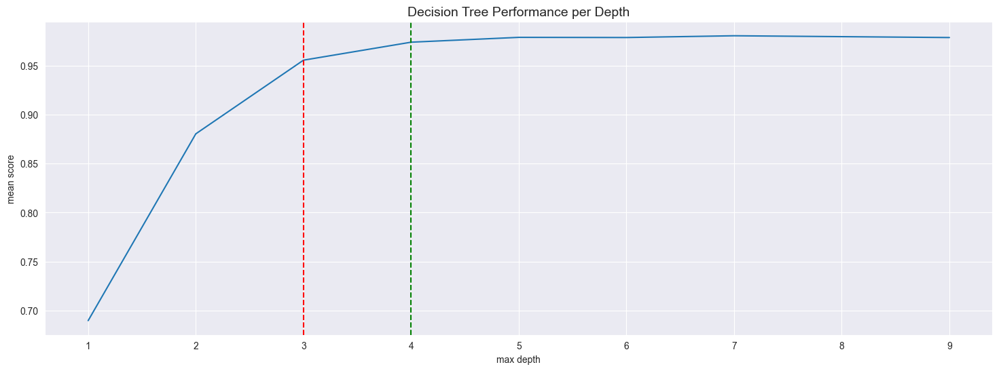

In [114]:
plt.figure(figsize=(18, 6))

plt.plot(tree_results['param_max_depth'], tree_results['mean_test_score'], label='True y')
plt.axvline(x=3, color='r', linestyle='--', label='x = 3')
plt.axvline(x=4, color='g', linestyle='--', label='x = 4')

plt.xticks(tree_results['param_max_depth'].astype(int))
plt.xlabel('max depth')
plt.ylabel('mean score')
plt.title('Decision Tree Performance per Depth', fontsize=14)

plt.savefig('Graphs/decision_tree_performance.png')
plt.show()

In [115]:
tree_regr = DecisionTreeRegressor(max_depth=4, random_state=33)
tree_regr.fit(X_train, y_train)

DecisionTreeRegressor(max_depth=4, random_state=33)

In [116]:
tree_regr.get_n_leaves()

16

In [117]:
tree_regr.score(X_test, y_test)

0.9649751606118954

In [118]:
model_metrics(tree_regr, X_test, y_test)

MAE: 1555.88
MSE: 4754687.47
RMSE: 2180.52
R2: 0.965


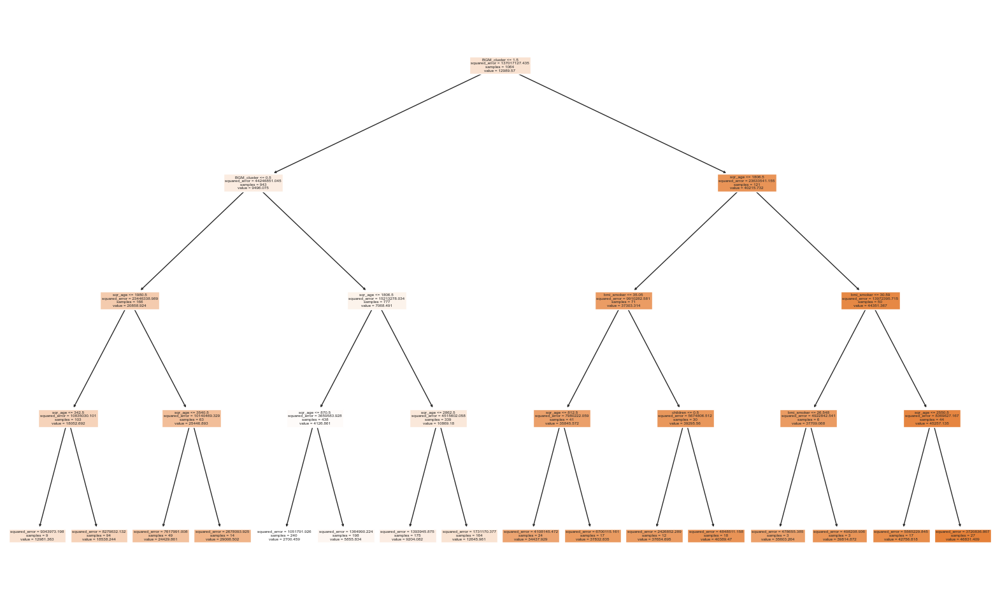

In [119]:
plt.figure(figsize=(20, 12))
plot_tree(tree_regr, filled=True, feature_names=X_train.columns)

plt.savefig('Graphs/decision_tree.png')
plt.show()

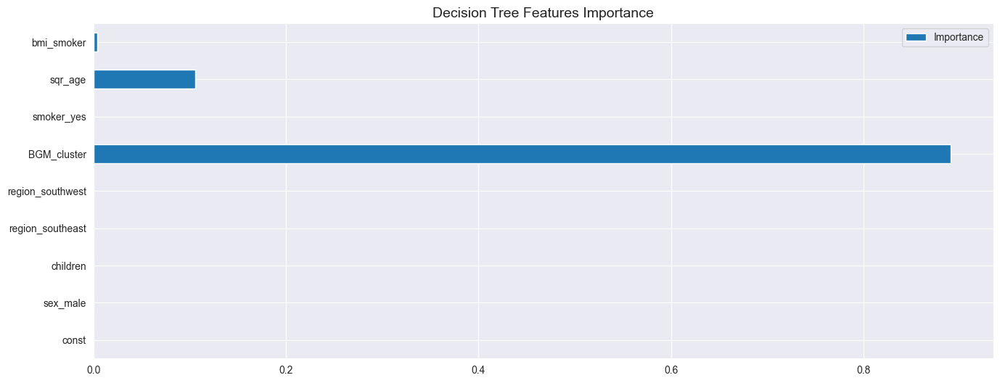

In [120]:
pd.DataFrame(list(zip(X_train.columns, tree_regr.feature_importances_)),
             columns=['Feature_name','Importance']).plot(kind='barh',
                                                         x='Feature_name',
                                                         y='Importance',
                                                         figsize=(16,6))
plt.title('Decision Tree Features Importance', fontsize=14)
plt.ylabel(None)
plt.savefig('Graphs/decision_tree_feature_importance.png')
plt.show()

In [121]:
scores = cross_val_score(DecisionTreeRegressor(max_depth=4), X, y)
print("Cross validation scores: ", scores)
print("Cross validation mean: ", round(scores.mean(), 5))

Cross validation scores:  [0.97417453 0.96698207 0.97282713 0.97123399 0.97008508]
Cross validation mean:  0.97106


### Random Forest Regressor

> Random Forest Regressor is a powerful and versatile algorithm for regression tasks, leveraging the strength of multiple decision trees to enhance predictive performance and generalization. <br> We can see the strength of a random forest in our project cause with no hyperparams we go up to 98.15%!!

In [122]:
rfr = RandomForestRegressor(random_state=33)
rfr.fit(X_train, y_train)

RandomForestRegressor(random_state=33)

In [123]:
rfr.score(X_test, y_test)

0.9810170036491342

In [124]:
model_metrics(rfr, X_test, y_test)

MAE: 675.99
MSE: 2576977.27
RMSE: 1605.3
R2: 0.981


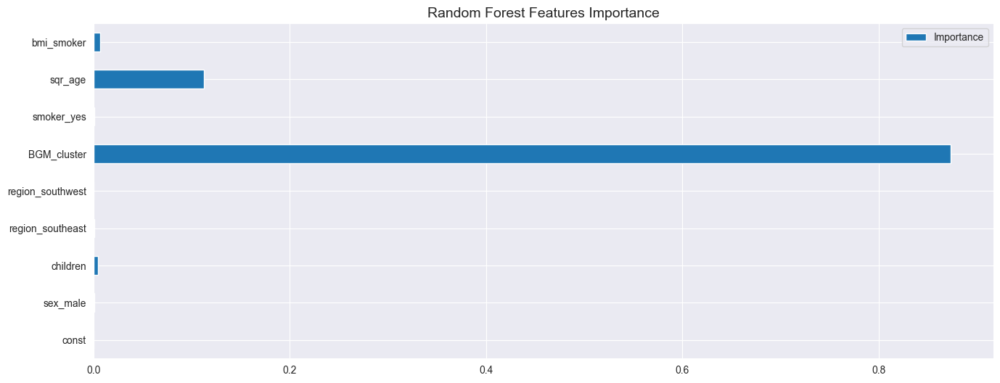

In [125]:
pd.DataFrame(list(zip(X_train.columns, rfr.feature_importances_)),
             columns=['Feature_name','Importance']).plot(kind='barh',
                                                         x='Feature_name',
                                                         y='Importance',
                                                         figsize=(16,6))
plt.title('Random Forest Features Importance', fontsize=14)
plt.ylabel(None)
plt.savefig('Graphs/random_forest_feature_importance.png')
plt.show()

In [126]:
scores = cross_val_score(RandomForestRegressor(), X, y)
print("Cross validation scores: ", scores)
print("Cross validation mean: ", round(scores.mean(), 5))

Cross validation scores:  [0.98101185 0.97864591 0.98525499 0.98281921 0.98207957]
Cross validation mean:  0.98196


### Random Forest Regressor Optuna

> From now and on we will stop the grid search cause the models now will have many hyperparams so we the grid search is very expensive in time and optuna's performance is on the roof. We can see that from a default Random Forest the Random Forest optuna gives us have a bit greater score but now we are near the top so every step become harder and harder

In [127]:
def objective_rfr(trial):

    n_estimators = trial.suggest_int('n_estimators', low=50, high=250, step=50)
    max_depth = trial.suggest_int('max_depth', 1, 30)
    min_samples_split = trial.suggest_int('min_samples_split', 2, 10)
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 5)
    bootstrap = trial.suggest_categorical('bootstrap', [True, False])
    
    rfr_optuna = RandomForestRegressor(n_estimators=n_estimators,
                                       max_depth=max_depth,
                                       min_samples_split=min_samples_split,
                                       min_samples_leaf=min_samples_leaf,
                                       bootstrap=bootstrap,
                                       n_jobs=-1,
                                       random_state=33
                                      )

    score = cross_val_score(rfr_optuna, X_train, y_train, scoring='r2', n_jobs=-1)
    return score.mean()

In [128]:
study_rfr = optuna.create_study(direction='maximize')
study_rfr.optimize(objective_rfr, n_trials=150)

[I 2024-01-29 21:38:14,940] A new study created in memory with name: no-name-c1b41395-a473-4277-846f-f298a368a6b1
[I 2024-01-29 21:38:15,110] Trial 0 finished with value: 0.9802620777032196 and parameters: {'n_estimators': 100, 'max_depth': 21, 'min_samples_split': 4, 'min_samples_leaf': 4, 'bootstrap': False}. Best is trial 0 with value: 0.9802620777032196.
[I 2024-01-29 21:38:15,237] Trial 1 finished with value: 0.9812781717203407 and parameters: {'n_estimators': 50, 'max_depth': 29, 'min_samples_split': 4, 'min_samples_leaf': 5, 'bootstrap': False}. Best is trial 1 with value: 0.9812781717203407.
[I 2024-01-29 21:38:15,379] Trial 2 finished with value: 0.975390670477258 and parameters: {'n_estimators': 100, 'max_depth': 4, 'min_samples_split': 2, 'min_samples_leaf': 4, 'bootstrap': False}. Best is trial 1 with value: 0.9812781717203407.
[I 2024-01-29 21:38:15,616] Trial 3 finished with value: 0.9856687978650488 and parameters: {'n_estimators': 150, 'max_depth': 24, 'min_samples_spli

In [129]:
print('Number of finished trials: ', len(study_rfr.trials))
print('Best trial:')
trial = study_rfr.best_trial

print('Value: ', trial.value)
print('Params: ')
for key, value in trial.params.items():
    print(f'    {key}: {value}')

Number of finished trials:  150
Best trial:
Value:  0.9858481006126443
Params: 
    n_estimators: 50
    max_depth: 25
    min_samples_split: 3
    min_samples_leaf: 3
    bootstrap: True


In [130]:
trials_df = study_rfr.trials_dataframe()
trials_df.sort_values(by='value', ascending=False).head()

,number,value,datetime_start,datetime_complete,duration,params_bootstrap,params_max_depth,params_min_samples_leaf,params_min_samples_split,params_n_estimators,state
149,149,0.985848,2024-01-29 21:38:44.486306,2024-01-29 21:38:44.611298,0 days 00:00:00.124992,True,23,3,3,50,COMPLETE
101,101,0.985848,2024-01-29 21:38:38.828086,2024-01-29 21:38:38.936167,0 days 00:00:00.108081,True,23,3,2,50,COMPLETE
116,116,0.985848,2024-01-29 21:38:40.607672,2024-01-29 21:38:40.718738,0 days 00:00:00.111066,True,23,3,2,50,COMPLETE
115,115,0.985848,2024-01-29 21:38:40.481953,2024-01-29 21:38:40.607672,0 days 00:00:00.125719,True,24,3,4,50,COMPLETE
114,114,0.985848,2024-01-29 21:38:40.370885,2024-01-29 21:38:40.480938,0 days 00:00:00.110053,True,21,3,2,50,COMPLETE


In [131]:
fig = plot_optimization_history(study_rfr)

fig.update_layout(yaxis_range=[0, 1], title="Random Forest Regressor Optuna's Performance")
fig.write_html('Graphs/rfr_optuna_performance1.html')
fig.show()

In [132]:
fig = plot_param_importances(study_rfr)

fig.update_layout(title="Random Forest Regressor Optuna's Hyperparameter Importance")

fig.write_html('Graphs/rfr_optuna_performance2.html')
fig.show()

In [133]:
fig = plot_rank(study_rfr)
fig.update_layout(title="Random Forest Regressor Optuna's Hyperparams Rank (Objective Value)", width=990, height=800)
fig.write_html('Graphs/rfr_optuna_performance3.html')
fig.show()

In [134]:
fig = plot_timeline(study_rfr)

fig.update_layout(title="Random Forest Regressor Optuna's Timeline")
fig.write_html('Graphs/rfr_optuna_timeline.html')
fig.show()

### Extra Tree Regressor

>Extra Trees Regressor is a variation of Random Forest that introduces extra randomness in the tree-building process, providing a different trade-off between bias and variance in the ensemble.

In [135]:
etr = ExtraTreesRegressor(random_state=33)
etr.fit(X_train, y_train)

ExtraTreesRegressor(random_state=33)

In [136]:
etr.get_params()

{'bootstrap': False,
 'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': None,
 'max_features': 1.0,
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'monotonic_cst': None,
 'n_estimators': 100,
 'n_jobs': None,
 'oob_score': False,
 'random_state': 33,
 'verbose': 0,
 'warm_start': False}

In [137]:
etr.score(X_test, y_test)

0.9793329177913822

In [138]:
model_metrics(etr, X_test, y_test)

MAE: 621.59
MSE: 2805595.07
RMSE: 1674.99
R2: 0.9793


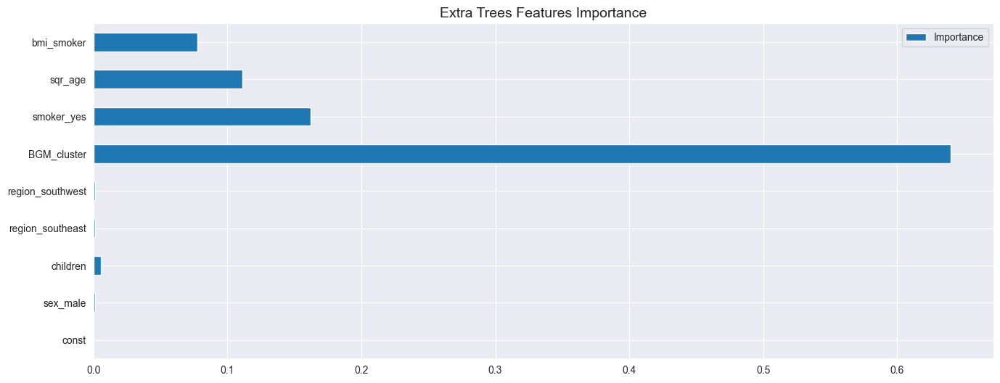

In [139]:
pd.DataFrame(list(zip(X_train.columns, etr.feature_importances_)),
             columns=['Feature_name','Importance']).plot(kind='barh',
                                                         x='Feature_name',
                                                         y='Importance',
                                                         figsize=(16,6))
plt.title('Extra Trees Features Importance', fontsize=14)
plt.ylabel(None)
plt.savefig('Graphs/extra_trees_feature_importance.png')
plt.show()

In [140]:
scores = cross_val_score(ExtraTreesRegressor(), X, y)
print("Cross validation scores: ", scores)
print("Cross validation mean: ", round(scores.mean(), 5))

Cross validation scores:  [0.98117913 0.97136835 0.98342617 0.98609946 0.97815945]
Cross validation mean:  0.98005


### Extra Trees Regressor Optuna

> The Extra Trees Regressor excels in handling complex relationships in insurance data, providing robust predictions while minimizing overfitting. With Optuna, we optimize hyperparameters to enhance its performance and ensure it generalizes well to new data.

In [141]:
def objective_etr(trial):
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 1000, step=100),
        'max_depth': trial.suggest_int('max_depth', 5, 30),
        'min_samples_split': trial.suggest_float('min_samples_split', 0.01, 0.5, log=True),
        'min_samples_leaf': trial.suggest_float('min_samples_leaf', 0.01, 0.5, log=True),
        'max_features': trial.suggest_categorical('max_features', ['sqrt', 'log2']),
        'min_weight_fraction_leaf': trial.suggest_float('min_weight_fraction_leaf', 0.0, 0.2),
    }
    etr_optuna = ExtraTreesRegressor(**params)

    score = cross_val_score(etr_optuna, X_train, y_train, scoring='r2', n_jobs=-1)
    return score.mean()

In [142]:
study_etr = optuna.create_study(direction='maximize')
study_etr.optimize(objective_etr, n_trials=150)

[I 2024-01-29 21:38:46,342] A new study created in memory with name: no-name-53dd306e-bc0b-45b1-a79d-19e9d441445c
[I 2024-01-29 21:38:46,753] Trial 0 finished with value: 0.7390518629599253 and parameters: {'n_estimators': 800, 'max_depth': 5, 'min_samples_split': 0.4792052656547548, 'min_samples_leaf': 0.09438180537499916, 'max_features': 'sqrt', 'min_weight_fraction_leaf': 0.07653888921797876}. Best is trial 0 with value: 0.7390518629599253.
[I 2024-01-29 21:38:47,103] Trial 1 finished with value: 0.9057275623896628 and parameters: {'n_estimators': 600, 'max_depth': 16, 'min_samples_split': 0.0371077553715414, 'min_samples_leaf': 0.012009581832355828, 'max_features': 'sqrt', 'min_weight_fraction_leaf': 0.029651206275282373}. Best is trial 1 with value: 0.9057275623896628.
[I 2024-01-29 21:38:47,311] Trial 2 finished with value: 0.7351659300235467 and parameters: {'n_estimators': 400, 'max_depth': 6, 'min_samples_split': 0.1969172353017737, 'min_samples_leaf': 0.015011126736989252, 'm

In [143]:
print('Number of finished trials: ', len(study_etr.trials))
print('Best trial:')
trial = study_etr.best_trial

print('Value: ', trial.value)
print('Params: ')
for key, value in trial.params.items():
    print(f'    {key}: {value}')

Number of finished trials:  150
Best trial:
Value:  0.9527292392901096
Params: 
    n_estimators: 900
    max_depth: 11
    min_samples_split: 0.020575003595732673
    min_samples_leaf: 0.010157416107992727
    max_features: sqrt
    min_weight_fraction_leaf: 2.8813890603045234e-06


In [144]:
trials_df = study_etr.trials_dataframe()
trials_df.sort_values(by='value', ascending=False).head()

,number,value,datetime_start,datetime_complete,duration,params_max_depth,params_max_features,params_min_samples_leaf,params_min_samples_split,params_min_weight_fraction_leaf,params_n_estimators,state
143,143,0.952729,2024-01-29 21:39:54.875822,2024-01-29 21:39:55.448833,0 days 00:00:00.573011,11,sqrt,0.010157,0.020575,0.000003,900,COMPLETE
145,145,0.951709,2024-01-29 21:39:56.022855,2024-01-29 21:39:56.579898,0 days 00:00:00.557043,11,sqrt,0.010301,0.017545,0.001183,900,COMPLETE
142,142,0.951558,2024-01-29 21:39:54.308816,2024-01-29 21:39:54.874822,0 days 00:00:00.566006,11,sqrt,0.010039,0.017389,0.000164,900,COMPLETE
149,149,0.951411,2024-01-29 21:39:58.271616,2024-01-29 21:39:58.841665,0 days 00:00:00.570049,11,sqrt,0.010085,0.018230,0.000242,900,COMPLETE
148,148,0.951316,2024-01-29 21:39:57.714947,2024-01-29 21:39:58.271616,0 days 00:00:00.556669,11,sqrt,0.010165,0.018217,0.000625,900,COMPLETE


In [145]:
fig = plot_optimization_history(study_etr)

fig.update_layout(yaxis_range=[0, 1], title="Extra Trees Regressor Optuna's Performance")
fig.write_html('Graphs/etr_optuna_performance1.html')
fig.show()

In [146]:
fig = plot_param_importances(study_etr)

fig.update_layout(title="Extra Trees Regressor Optuna's Hyperparameter Importance")

fig.write_html('Graphs/etr_optuna_performance2.html')
fig.show()

In [147]:
fig = plot_rank(study_etr)
fig.update_layout(title="Extra Trees Regressor Optuna's Hyperparams Rank (Objective Value)", width=1300, height=1200)
fig.write_html('Graphs/etr_optuna_performance3.html')
fig.show()

In [148]:
fig = plot_timeline(study_etr)

fig.update_layout(title="Extra Trees Regressor Optuna's Timeline")
fig.write_html('Graphs/etr_optuna_timeline.html')
fig.show()

### Gradient Boosting Regressor

> Gradient Boosting Regressor is an ensemble technique that builds trees sequentially, each correcting the errors of the previous one. This model is effective in capturing intricate patterns in insurance data and improving predictive accuracy.

In [149]:
gbr = GradientBoostingRegressor(random_state=33)
gbr.fit(X_train, y_train)

GradientBoostingRegressor(random_state=33)

In [150]:
gbr.score(X_test, y_test)

0.9819717231407463

In [151]:
model_metrics(gbr, X_test, y_test)

MAE: 724.8
MSE: 2447372.31
RMSE: 1564.41
R2: 0.982


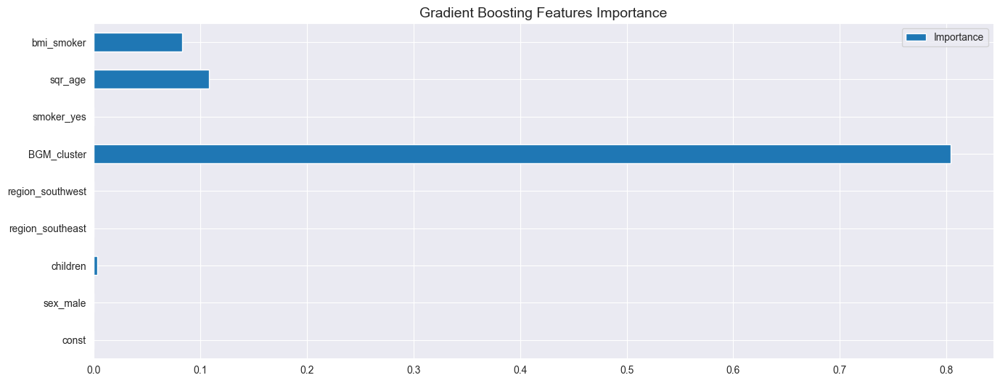

In [152]:
pd.DataFrame(list(zip(X_train.columns, gbr.feature_importances_)),
             columns=['Feature_name','Importance']).plot(kind='barh',
                                                         x='Feature_name',
                                                         y='Importance',
                                                         figsize=(16,6))
plt.title('Gradient Boosting Features Importance', fontsize=14)
plt.ylabel(None)
plt.savefig('Graphs/gradient_boosting_feature_importance.png')
plt.show()

In [153]:
scores = cross_val_score(GradientBoostingRegressor(), X, y)
print("Cross validation scores: ", scores)
print("Cross validation mean: ", round(scores.mean(), 5))

Cross validation scores:  [0.98774155 0.9822556  0.98267222 0.98956035 0.98524931]
Cross validation mean:  0.9855


### Gradient Boosting Regressor Optuna

> Gradient Boosting is the most promising model we have till now, lets see with optuna what can we get from that.

In [154]:
def objective_gbr(trial):
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 1000, step=100),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.2, log=True),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'min_samples_split': trial.suggest_float('min_samples_split', 0.01, 0.5, log=True),
        'min_samples_leaf': trial.suggest_float('min_samples_leaf', 0.01, 0.5, log=True),
        'max_features': trial.suggest_categorical('max_features', ['sqrt', 'log2']),
        'subsample': trial.suggest_float('subsample', 0.5, 1.0),
        'random_state': 33
    }
    
    gbr_optuna = GradientBoostingRegressor(**params)

    score = cross_val_score(gbr_optuna, X_train, y_train, scoring='r2', n_jobs=-1)
    return score.mean()

In [155]:
study_gbr = optuna.create_study(direction='maximize')
study_gbr.optimize(objective_gbr, n_trials=150)

[I 2024-01-29 21:40:00,865] A new study created in memory with name: no-name-8aa3d389-d987-4bba-a2aa-834007ef9025
[I 2024-01-29 21:40:00,974] Trial 0 finished with value: 0.9191679176974473 and parameters: {'n_estimators': 200, 'learning_rate': 0.05058260500958408, 'max_depth': 7, 'min_samples_split': 0.014107447879303119, 'min_samples_leaf': 0.06096203276327615, 'max_features': 'sqrt', 'subsample': 0.5038413836749671}. Best is trial 0 with value: 0.9191679176974473.
[I 2024-01-29 21:40:01,387] Trial 1 finished with value: 0.07896635712156905 and parameters: {'n_estimators': 1000, 'learning_rate': 0.0122401357815511, 'max_depth': 7, 'min_samples_split': 0.2789222093198886, 'min_samples_leaf': 0.24485298042545253, 'max_features': 'log2', 'subsample': 0.936408696816243}. Best is trial 0 with value: 0.9191679176974473.
[I 2024-01-29 21:40:01,833] Trial 2 finished with value: 0.9835134258134364 and parameters: {'n_estimators': 800, 'learning_rate': 0.015832330522016772, 'max_depth': 7, 'mi

In [156]:
print('Number of finished trials: ', len(study_gbr.trials))
print('Best trial:')
trial = study_gbr.best_trial

print('Value: ', trial.value)
print('Params: ')
for key, value in trial.params.items():
    print(f'    {key}: {value}')

Number of finished trials:  150
Best trial:
Value:  0.9860713720375396
Params: 
    n_estimators: 1000
    learning_rate: 0.054196049649591925
    max_depth: 4
    min_samples_split: 0.06265930011609201
    min_samples_leaf: 0.02411684327409094
    max_features: log2
    subsample: 0.9316686378583763


In [157]:
trials_df = study_gbr.trials_dataframe()
trials_df.sort_values(by='value', ascending=False).head()

,number,value,datetime_start,datetime_complete,duration,params_learning_rate,params_max_depth,params_max_features,params_min_samples_leaf,params_min_samples_split,params_n_estimators,params_subsample,state
147,147,0.986071,2024-01-29 21:41:05.321605,2024-01-29 21:41:05.871807,0 days 00:00:00.550202,0.054196,4,log2,0.024117,0.062659,1000,0.931669,COMPLETE
123,123,0.986058,2024-01-29 21:40:52.674621,2024-01-29 21:40:53.199134,0 days 00:00:00.524513,0.044284,4,log2,0.023492,0.050263,1000,0.978862,COMPLETE
114,114,0.985978,2024-01-29 21:40:47.755273,2024-01-29 21:40:48.311295,0 days 00:00:00.556022,0.043010,4,log2,0.026587,0.046875,1000,0.945630,COMPLETE
112,112,0.985924,2024-01-29 21:40:46.656387,2024-01-29 21:40:47.214417,0 days 00:00:00.558030,0.047547,4,log2,0.026924,0.037993,1000,0.951176,COMPLETE
145,145,0.985903,2024-01-29 21:41:04.203157,2024-01-29 21:41:04.760577,0 days 00:00:00.557420,0.047911,4,log2,0.025280,0.046759,1000,0.941604,COMPLETE


In [158]:
fig = plot_optimization_history(study_gbr)

fig.update_layout(yaxis_range=[0, 1], title="Gradient Boosting Regressor Optuna's Performance")
fig.write_html('Graphs/gbr_optuna_performance1.html')
fig.show()

In [159]:
fig = plot_param_importances(study_gbr)

fig.update_layout(title="Gradient Boosting Regressor Optuna's Hyperparameter Importance")

fig.write_html('Graphs/gbr_optuna_performance2.html')
fig.show()

In [160]:
fig = plot_rank(study_gbr)

fig.update_layout(title="Gradient Boosting Regressor Optuna's Hyperparams Rank (Objective Value)",
                  width=1400,
                  height=1100
                 )
fig.write_html('Graphs/gbr_optuna_performance3.html')
fig.show()

In [161]:
fig = plot_timeline(study_gbr)

fig.update_layout(title="Gradient Boosting Regressor Optuna's Timeline")
fig.write_html('Graphs/gbr_optuna_timeline.html')
fig.show()

### AdaBoost Regressor

> AdaBoost Regressor is another ensemble learning algorithm that combines weak learners into a strong one. In the context of insurance, it adapts to the nuances of the data and emphasizes areas where previous models may have underperformed.

In [162]:
adr = AdaBoostRegressor(random_state=33)
adr.fit(X_train, y_train)

AdaBoostRegressor(random_state=33)

In [163]:
adr.score(X_test, y_test)

0.9605332958847302

In [164]:
model_metrics(adr, X_test, y_test)

MAE: 1777.13
MSE: 5357678.92
RMSE: 2314.67
R2: 0.9605


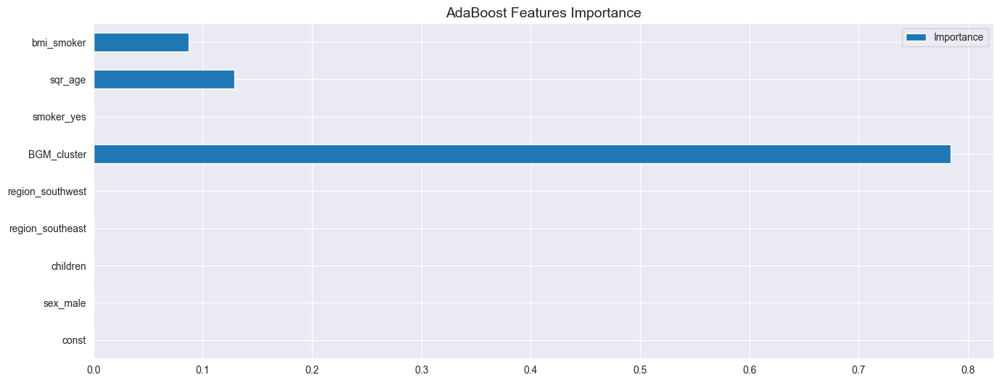

In [165]:
pd.DataFrame(list(zip(X_train.columns, adr.feature_importances_)),
             columns=['Feature_name','Importance']).plot(kind='barh',
                                                         x='Feature_name',
                                                         y='Importance',
                                                         figsize=(16,6))
plt.title('AdaBoost Features Importance', fontsize=14)
plt.ylabel(None)
plt.savefig('Graphs/adaboost_feature_importance.png')
plt.show()

In [166]:
scores = cross_val_score(AdaBoostRegressor(), X, y)
print("Cross validation scores: ", scores)
print("Cross validation mean: ", round(scores.mean(), 5))

Cross validation scores:  [0.96698352 0.95685845 0.95752775 0.96583517 0.96982666]
Cross validation mean:  0.96341


### AdaBoost Regressor Optuna

> AdaBoost did great but lets check if optuna's parameter iterative tuning process has as a result to improve the model's ability to adapt and perform well across a broader range of scenarios

In [167]:
def objective_ada(trial):
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 50, 500, step=50),
        # 'learning_rate': trial.suggest_float('learning_rate', .01, .2),
        'loss': trial.suggest_categorical('loss', ['linear', 'square', 'exponential']),
        'random_state': 33
    }
    abr = AdaBoostRegressor(**params)
    
    score = cross_val_score(abr, X_train, y_train, scoring='r2', cv=5)

    return score.mean()

In [168]:
study_adaboost = optuna.create_study(direction='maximize')
study_adaboost.optimize(objective_ada, n_trials=150)

[I 2024-01-29 21:41:09,100] A new study created in memory with name: no-name-72552d1a-9775-4c52-8374-e4326929468d
[I 2024-01-29 21:41:10,611] Trial 0 finished with value: 0.9582013405165763 and parameters: {'n_estimators': 400, 'loss': 'square'}. Best is trial 0 with value: 0.9582013405165763.
[I 2024-01-29 21:41:10,834] Trial 1 finished with value: 0.9620271527093316 and parameters: {'n_estimators': 50, 'loss': 'exponential'}. Best is trial 1 with value: 0.9620271527093316.
[I 2024-01-29 21:41:11,454] Trial 2 finished with value: 0.9455834904961025 and parameters: {'n_estimators': 150, 'loss': 'exponential'}. Best is trial 1 with value: 0.9620271527093316.
[I 2024-01-29 21:41:13,067] Trial 3 finished with value: 0.9407457039529075 and parameters: {'n_estimators': 400, 'loss': 'exponential'}. Best is trial 1 with value: 0.9620271527093316.
[I 2024-01-29 21:41:14,891] Trial 4 finished with value: 0.9576803831612132 and parameters: {'n_estimators': 500, 'loss': 'square'}. Best is trial 1

In [169]:
print('Number of finished trials: ', len(study_adaboost.trials))
print('Best trial:')
trial = study_adaboost.best_trial

print('Value: ', trial.value)
print('Params: ')
for key, value in trial.params.items():
    print(f'    {key}: {value}')

Number of finished trials:  150
Best trial:
Value:  0.9629258374137152
Params: 
    n_estimators: 500
    loss: linear


In [170]:
trials_df = study_adaboost.trials_dataframe()
trials_df.sort_values(by='value', ascending=False).head()

,number,value,datetime_start,datetime_complete,duration,params_loss,params_n_estimators,state
75,75,0.962926,2024-01-29 21:41:38.973576,2024-01-29 21:41:39.079575,0 days 00:00:00.105999,linear,400,COMPLETE
102,102,0.962926,2024-01-29 21:41:46.833764,2024-01-29 21:41:46.940767,0 days 00:00:00.107003,linear,350,COMPLETE
94,94,0.962926,2024-01-29 21:41:43.982638,2024-01-29 21:41:44.089659,0 days 00:00:00.107021,linear,50,COMPLETE
95,95,0.962926,2024-01-29 21:41:44.090660,2024-01-29 21:41:44.196656,0 days 00:00:00.105996,linear,200,COMPLETE
96,96,0.962926,2024-01-29 21:41:44.197656,2024-01-29 21:41:44.305659,0 days 00:00:00.108003,linear,100,COMPLETE


In [171]:
fig = plot_optimization_history(study_adaboost)

fig.update_layout(yaxis_range=[0, 1], title="AdaBoost Regressor Optuna's Performance")
fig.write_html('Graphs/ada_optuna_performance1.html')
fig.show()

In [172]:
fig = plot_param_importances(study_adaboost)

fig.update_layout(title="AdaBoost Regressor Optuna's Hyperparameter Importance")

fig.write_html('Graphs/ada_optuna_performance2.html')
fig.show()

In [173]:
fig = plot_rank(study_adaboost)
fig.update_layout(title="AdaBoost Regressor Optuna's Hyperparams Rank (Objective Value)", width=850, height=550)
fig.write_html('Graphs/ada_optuna_performance3.html')
fig.show()

In [174]:
fig = plot_timeline(study_adaboost)

fig.update_layout(title="AdaBoost Regressor Optuna's Timeline")
fig.write_html('Graphs/ada_optuna_timeline.html')
fig.show()

### KNN Regressor

> The KNN Regressor predicts insurance outcomes based on the similarity of data points. It is particularly useful when there are local patterns or clusters in the data. So lets see how this performes

In [175]:
params = {
    'n_neighbors': list(range(1, 15)),
    'weights': ['uniform', 'distance'],
    'n_jobs': [-1]
}
knn_grid_search = GridSearchCV(KNeighborsRegressor(), params)
knn_grid_search.fit(X_train, y_train)

GridSearchCV(estimator=KNeighborsRegressor(),
             param_grid={'n_jobs': [-1],
                         'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                         13, 14],
                         'weights': ['uniform', 'distance']})

In [176]:
knn_grid_search.best_params_

{'n_jobs': -1, 'n_neighbors': 2, 'weights': 'distance'}

In [177]:
knn_grid_search.best_score_

0.7545567782037699

In [178]:
knn_grid_search.score(X_test, y_test)

0.7437096015387024

In [179]:
model_metrics(knn_grid_search, X_test, y_test)

MAE: 2660.5
MSE: 34791901.04
RMSE: 5898.47
R2: 0.7437


In [180]:
pd.DataFrame(knn_grid_search.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_jobs,param_n_neighbors,param_weights,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.001800,4.007827e-04,0.029121,0.001129,-1,1,uniform,"{'n_jobs': -1, 'n_neighbors': 1, 'weights': 'u...",0.685949,0.804605,0.686761,0.804164,0.637873,0.723870,0.068082,5
1,0.001599,4.899610e-04,0.030005,0.000602,-1,1,distance,"{'n_jobs': -1, 'n_neighbors': 1, 'weights': 'd...",0.685949,0.804605,0.686761,0.804164,0.637873,0.723870,0.068082,5
2,0.001600,4.900972e-04,0.029496,0.000662,-1,2,uniform,"{'n_jobs': -1, 'n_neighbors': 2, 'weights': 'u...",0.643633,0.779287,0.699101,0.746721,0.720133,0.717775,0.045767,7
3,0.002000,1.981027e-06,0.029489,0.000967,-1,2,distance,"{'n_jobs': -1, 'n_neighbors': 2, 'weights': 'd...",0.688490,0.809663,0.724951,0.806158,0.743521,0.754557,0.047037,1
4,0.001599,4.899025e-04,0.029711,0.000924,-1,3,uniform,"{'n_jobs': -1, 'n_neighbors': 3, 'weights': 'u...",0.567047,0.733353,0.632981,0.711387,0.704908,0.669935,0.061506,12
5,0.002200,4.004722e-04,0.029638,0.000487,-1,3,distance,"{'n_jobs': -1, 'n_neighbors': 3, 'weights': 'd...",0.667516,0.804130,0.711027,0.794852,0.750377,0.745580,0.051316,2
6,0.002001,2.515966e-06,0.029705,0.000420,-1,4,uniform,"{'n_jobs': -1, 'n_neighbors': 4, 'weights': 'u...",0.542730,0.661178,0.555479,0.637784,0.704344,0.620303,0.062063,18
7,0.001599,4.887351e-04,0.030111,0.000549,-1,4,distance,"{'n_jobs': -1, 'n_neighbors': 4, 'weights': 'd...",0.668745,0.784841,0.689937,0.776813,0.772881,0.738644,0.049034,3
8,0.001999,1.393475e-06,0.029497,0.000473,-1,5,uniform,"{'n_jobs': -1, 'n_neighbors': 5, 'weights': 'u...",0.510518,0.593411,0.504020,0.576704,0.673453,0.571621,0.061925,19
9,0.002000,8.449576e-07,0.029731,0.000374,-1,5,distance,"{'n_jobs': -1, 'n_neighbors': 5, 'weights': 'd...",0.667486,0.768764,0.675283,0.757671,0.772310,0.728303,0.046789,4


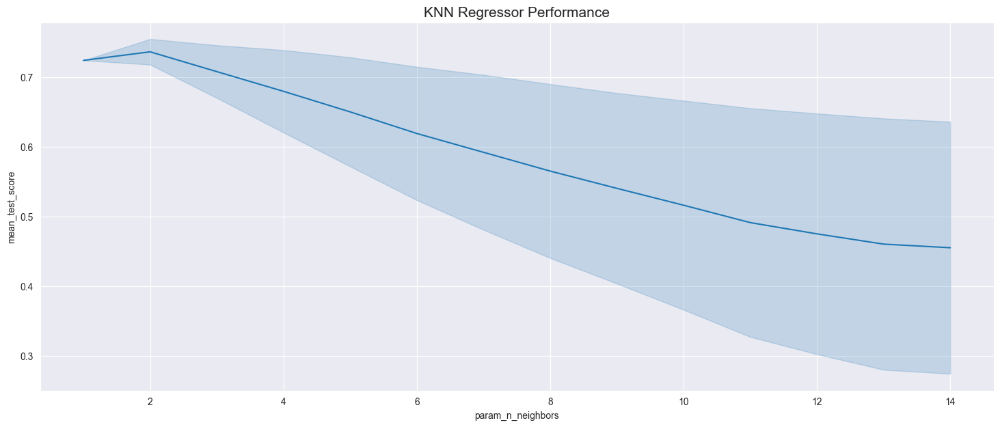

In [181]:
plt.figure(figsize=(18, 7))

sns.lineplot(data=pd.DataFrame(knn_grid_search.cv_results_),
             x='param_n_neighbors',
             y='mean_test_score'
            )
plt.title('KNN Regressor Performance', fontsize=15)
plt.savefig('Graphs/knn_regressor_performance.png')
plt.show()

## 5. Results
---

>The table below provides a comprehensive summary of the performance metrics for various machine learning models applied to insurance data. The performance metrics include accuracy scores, cross-validation results, and optimization outcomes through grid search and Optuna.

|                                 | **Performance** | **Cross Validation** | **Grid Search** | **Optuna** | 
|---------------------------------|-----------------|----------------------|-----------------|------------|
| **Decision Tree**               |   **96.50%**    |      **97.10%**      |   **97.39%**    |   **-**    |
| **Random Forest**               |   **98.10%**    |      **98.20%**      |      **-**      | **98.59%** |
| **Extra Trees Regressor**       |   **97.93%**    |      **98.00%**      |      **-**      | **95.27%** |
| **Gradient Boosting Regressor** |   **98.20%**    |      **98.55%**      |      **-**      | **98.60%** |
| **AdaBoost Regressor**          |   **96.05%**    |      **96.34%**      |      **-**      | **96.29%** |
| **KNN Regressor**               |     **-**       |        **-**         |   **74.37%**    |   **-**    |
| **SVR**                         |   **95.85%**    |        **-**         |   **96.27%**    | **98.05%** |
| **SGDR**                        |   **75.50%**    |        **-**         |   **75.19%**    | **84.92%** |
| **Linear Regression**           |   **78.84%**    |      **83.48%**      |      **-**      |   **-**    |
| **Ridge Regression**            |   **78.85%**    |      **78.84%**      |      **-**      |   **-**    |
| **Bayesian Ridge Regression**   |   **78.86%**    |        **-**         |      **-**      | **85.13%** |
| **Lasso Regression**            |   **78.87%**    |      **78.86%**      |      **-**      |   **-**    |

## 6. Model Exportation
---

> In this section, we detail the exportation process of two highly-performing machine learning models: Random Forest and Gradient Boosting Regressors. These models have demonstrated exceptional predictive capabilities in our insurance project.

**Random Forest Regressor Export**

The Random Forest Regressor, with an impressive performance basic score of **98.20%**, is selected for exportation. The following steps outline the process:

1. **Training and Optimization:** The Random Forest model underwent training and hyperparameter optimization using techniques such as cross-validation and grid search. Optuna played a crucial role in fine-tuning hyperparameters, resulting in an optimized model with a performance boost to **98.59%** accuracy.

2. **Exportation Format:** The Random Forest Regressor is exported in a serialized format, commonly a Python Pickle file. This allows for seamless integration into deployment environments.

**Gradient Boosting Regressor Export**

The Gradient Boosting Regressor, showcasing an outstanding basic score of **98.20%**, is chosen for exportation. The export process is outlined as follows:

1. **Training and Optimization:** Similar to the Random Forest, the Gradient Boosting model underwent rigorous training and hyperparameter tuning. Optuna contributed significantly to achieving the optimal configuration, resulting in a performance level of **98.60%**.

2. **Exportation Format:** The Gradient Boosting Regressor is serialized into a format suitable for deployment. Common serialization formats include Pickle or other binary formats, ensuring compatibility across different environments.

In [182]:
random_forest = RandomForestRegressor(**study_rfr.best_trial.params).fit(X, y)
gradient_boosting = GradientBoostingRegressor(**study_gbr.best_trial.params).fit(X, y)

with open('Models/Random Forest Regressor.pkl', 'wb') as file:
    pickle.dump(random_forest, file)

with open('Models/Gradient Boosting Regressor.pkl', 'wb') as file:
    pickle.dump(gradient_boosting, file)